In [1]:
# -------------------- Test --------------------
import os
import torch
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn.functional as F
from transformers import CLIPModel, CLIPProcessor
from torch.utils.data import  Dataset
from IPython.display import display
from peft import PeftModel
from PIL import Image


# Define a function to load the necessary components for the model evaluation
def load_nec(csv_path, image_folder, model_path, device, base_model_path = None):
    # Load CSV data
    data = pd.read_csv(csv_path)
    print(f"Total number of samples: {len(data)}")
    # Initialize flags to track model loading method and success
    merged_successfully = False
    is_lora = False
    # Try to run when the model_path is a complete model directory
    try:
        print(f"Attempting to load complete model: {model_path}")
        processor = CLIPProcessor.from_pretrained(model_path)
        model = CLIPModel.from_pretrained(model_path)
        print(f"Successfully loaded complete model.")
    # When the model_path is LoRA adapter directory
    except Exception as e:   
        print(f"Complete model loading failed: {e}")
        print(f"Attempting to load as LoRA adapter: ")
        # Ensure base model path is provided for LoRA loading
        assert base_model_path is not None, "LoRA adapter directory requires base_model_path"
        try:
            print(f"Loading base model: {base_model_path}") # Load the base model first
            processor = CLIPProcessor.from_pretrained(base_model_path)
            base = CLIPModel.from_pretrained(base_model_path)
            # Load LoRA adapter on top of base model
            print(f"Loading LoRA adapter: {model_path}")
            model = PeftModel.from_pretrained(base, model_path)
            is_lora = True
            # Try to merge LoRA weights with base model
            print(f"Attempting to merge LoRA weights...")
            try:
                model = model.merge_and_unload()
                merged_successfully = True
                print(f"LoRA weights merged successfully.")
            except Exception as merge_e:
                print(f"LoRA weight merging failed, using original model: {merge_e}")
        except Exception as lora_e:
            raise RuntimeError(f"LoRA model loading failed: {lora_e}")
    # Move model to device and set to evaluation mode
    model = model.to(device)
    model.eval()
    # Create TestDataset
    print(f"Creating test dataset: ")
    dataset = TestDataset(data, processor, image_folder)
    # Preprocess unique paintings information
    unique_paintings = data[['PAINTING_ID', 'PATH']].drop_duplicates().reset_index(drop = True)
    painting_to_idx = {pid: idx for idx, pid in enumerate(unique_paintings['PAINTING_ID'])}
    # Print outcomes
    print(f" * Number of unique artworks: {len(unique_paintings)}")
    print(f" * Number of query utterances: {len(data)}")
    # Collect metadata
    metadata = {
        'model_path': model_path,
        'base_model_path': base_model_path,
        'is_lora': is_lora,
        'merged_successfully': merged_successfully,
        'num_unique_paintings': len(unique_paintings),
        'num_utterances': len(data),
        'device': str(device),
        'csv_path': csv_path,
        'image_folder': image_folder
    }
    print(f"Model and data loading completed.")
    # Return all components needed for evaluation in a single dictionary
    return {
        'data': data,
        'processor': processor, 
        'model': model,
        'dataset': dataset,
        'unique_paintings': unique_paintings,
        'painting_to_idx': painting_to_idx,
        'device': device,
        'metadata': metadata
    }

# Define a dataset to handle test data in retrieval evaluation
class TestDataset:
    # Initialise the test dataset with necessary components
    def __init__(self, data, processor, image_folder):
        self.data = data
        self.processor = processor
        self.image_folder = image_folder
        # Extract unique paintings
        self.unique_paintings = data[['PAINTING_ID', 'PATH']].drop_duplicates().reset_index(drop = True)
        self.utterances = data[['UTTERANCE', 'PAINTING_ID']].copy()
        # Keep utterance-painting pairs for evaluation mapping
        self.painting_to_idx = {pid: idx for idx, pid in enumerate(self.unique_paintings['PAINTING_ID'])}
        # Check for missing image files during initialization
        self._validate_images()
    # Validate that all referenced image files exist
    def _validate_images(self):
        # Create an empty list to contain missing images
        missing_images = []
        # Check each unique painting's image file
        for _, row in self.unique_paintings.iterrows():
            image_path = os.path.join(self.image_folder, row['PATH'])
            if not os.path.exists(image_path):
                missing_images.append(row['PATH'])
        # Print missing files
        if missing_images:
            print(f"Found {len(missing_images)} missing image files:")
            for img in missing_images[:5]:  # Only show first 5
                print(f" - {img}")
            if len(missing_images) > 5:
                print(f" ... and {len(missing_images) - 5} more")
    # Load and preprocess a batch of images from given indices
    def get_image_batch(self, indices, device):
        # Create empty lists to contain images and valid indices
        images = []
        valid_indices = []
        # Load each image in the batch
        for idx in indices:
            try:
                row = self.unique_paintings.iloc[idx]
                image_path = os.path.join(self.image_folder, row['PATH'])
                # Load and convert image to RGB format
                if os.path.exists(image_path):
                    image = Image.open(image_path).convert('RGB')
                    images.append(image)
                    valid_indices.append(idx)
                else:
                    print(f"Image file does not exist: {image_path}")
            except Exception as e:
                print(f"Failed to load image (idx = {idx}): {e}")
        # Ensure at least one valid image was loaded
        if not images:
            raise RuntimeError("No valid images to process")
        # Apply CLIP image preprocessing and move to the device
        inputs = self.processor(images = images, return_tensors = "pt", padding = True)
        pixel_values = inputs['pixel_values'].to(device)
        return pixel_values, valid_indices
    # Define a function to get the text batch
    def get_text_batch(self, texts, device):
        # Apply CLIP text preprocessing with padding and truncation
        inputs = self.processor(text = texts, return_tensors = "pt", padding = True, truncation = True)
        input_ids = inputs['input_ids'].to(device)
        attention_mask = inputs['attention_mask'].to(device)
        return input_ids, attention_mask
    # Define a function to the total number of utterance-painting pairs in the dataset
    def __len__(self):
        return len(self.data)
    # Define a function to retrieve a single sample from the dataset
    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        return {
            'utterance': row['UTTERANCE'],
            'painting_id': row['PAINTING_ID'],
            'path': row['PATH']
        }

# Define a function to run the model
def run_model(csv_path, image_folder, model_path, device, base_model_path = None, batch_size = 32):
    # Load model and dataset
    print(f"\nStarting evaluation for model: {os.path.basename(model_path)}")
    loaded = load_nec(csv_path, image_folder, model_path, device, base_model_path)
    # Do the full retrieval evaluation
    print(f"Starting full retrieval evaluation: ")
    detail = evaluate_full_retrieval(
        model = loaded['model'],
        dataset = loaded['dataset'],
        unique_paintings = loaded['unique_paintings'],
        painting_to_idx = loaded['painting_to_idx'],
        device = device,
        batch_size = batch_size
    )
    # Add metadata
    detail['metadata'] = loaded['metadata']
    detail['data'] = loaded['data']
    detail['model_name'] = os.path.basename(model_path)
    print(f"Model evaluation completed: {detail['model_name']}")
    return detail

# Define a functio nto evaluate the full retrieval accuracy
def evaluate_full_retrieval(model, dataset, unique_paintings, painting_to_idx, device, batch_size = 32, topk = (1, 5, 10)):
    # Convert model to evaluation mode
    model.eval()
    # Extract features for all unique images in batches
    print(f"Extracting image features for {len(unique_paintings)} unique artworks: ")
    all_image_feats = []
    # Loop through to process images in batches to manage memory usage
    for i in range(0, len(unique_paintings), batch_size):
        end_idx = min(i + batch_size, len(unique_paintings))
        batch_indices = list(range(i, end_idx))
        try:
            # Load and preprocess batch of images
            pixel_values, valid_indices = dataset.get_image_batch(batch_indices, device)
            # Extract image features without gradient computation for efficiency
            with torch.no_grad():
                # Normalize features to unit length for cosine similarity computation
                image_feats = model.get_image_features(pixel_values = pixel_values)
                image_feats = F.normalize(image_feats, dim = -1)
                # Move to CPU to save GPU memory and allow concatenation
                all_image_feats.append(image_feats.cpu())
        except Exception as e:
            print(f"Image batch {i} - {end_idx} processing failed: {e}")
            continue
    # Ensure at least some image features were extracted successfully
    if not all_image_feats:
        raise RuntimeError("Failed to extract any image features")
    # Concatenate all image features and move back to device for similarity computation
    all_image_feats = torch.cat(all_image_feats, dim = 0).to(device)
    print(f"Image features shape: {all_image_feats.shape}")
    # Process utterances and compute similarities
    print(f"Processing {len(dataset.data)} query utterances: ")
    # Create empty lists to store metrics
    results = []
    gt_ranks = []
    gt_sims = []
    all_text_feats = []
    # Extract all utterances for batch processing
    utterances = dataset.data['UTTERANCE'].tolist()
    # Extract all text features in batches
    for i in range(0, len(utterances), batch_size):
        end_idx = min(i + batch_size, len(utterances))
        batch_texts = utterances[i:end_idx]
        try:
            # Tokenize and preprocess batch of text utterances
            input_ids, attention_mask = dataset.get_text_batch(batch_texts, device)
           # Extract text features without gradient computation
            with torch.no_grad():
                text_feats = model.get_text_features(input_ids = input_ids, attention_mask = attention_mask)
                # Normalize features to unit length for cosine similarity
                text_feats = F.normalize(text_feats, dim = - 1)
                all_text_feats.append(text_feats.cpu())    
        except Exception as e:
            print(f"Text batch {i} - {end_idx} processing failed: {e}")
            continue
    # Concatenate all text features and move back to device
    all_text_feats = torch.cat(all_text_feats, dim = 0).to(device)
    print(f"Text features shape: {all_text_feats.shape}")
    # Compute similarity matrix and evaluate
    print(f"Computing similarity matrix: ")
    # Compute cosine similarity between all text-image pairs
    similarities = all_text_feats @ all_image_feats.T
    # Loop through to evaluate each utterance individually
    for idx, (_, row) in enumerate(dataset.data.iterrows()):
        utterance = row['UTTERANCE']
        gt_painting_id = row['PAINTING_ID']
        # Find ground truth index in unique_paintings
        if gt_painting_id not in painting_to_idx:
            print(f"Cannot find painting_id: {gt_painting_id}")
            continue
        gt_idx = painting_to_idx[gt_painting_id]
        # Get similarity scores for this utterance
        sim_scores = similarities[idx]
        # Sort and compute rank
        sorted_indices = sim_scores.argsort(descending = True)
        gt_rank = (sorted_indices == gt_idx).nonzero(as_tuple = True)[0].item() + 1
        gt_sim = sim_scores[gt_idx].item()
        results.append({
            'utterance': utterance,
            'gt_painting_id': gt_painting_id,
            'gt_rank': gt_rank,
            'gt_similarity': gt_sim
        })
        gt_ranks.append(gt_rank)
        gt_sims.append(gt_sim)
    # Calculate Top-K accuracy
    total = len(results)
    topk_acc = {}
    for k in topk:
        hits = sum(1 for r in results if r['gt_rank'] <= k)
        topk_acc[f"Top-{k} Accuracy"] = hits / total if total > 0 else 0.0
    print(f"Evaluation completed.")
    return {
        'topk': topk_acc,
        'gt_ranks': gt_ranks,
        'gt_sims': gt_sims,
        'similarities': similarities.cpu(),
        'image_feats': all_image_feats.cpu(),
        'text_feats': all_text_feats.cpu(),
        'results': results,
        'unique_paintings': unique_paintings,
       'painting_to_idx': painting_to_idx
    }

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Using MPS (Apple Silicon GPU)

Starting evaluation for model: final_model
Total number of samples: 1360
Attempting to load complete model: /Users/cyq/Desktop/Dissertation/Database/m1_clip_trained/final_model
Successfully loaded complete model.
Creating test dataset: 
 * Number of unique artworks: 214
 * Number of query utterances: 1360
Model and data loading completed.
Starting full retrieval evaluation: 
Extracting image features for 214 unique artworks: 
Image features shape: torch.Size([214, 512])
Processing 1360 query utterances: 
Text features shape: torch.Size([1360, 512])
Computing similarity matrix: 
Evaluation completed.
Model evaluation completed: final_model

Starting evaluation for model: final_model
Total number of samples: 1360
Attempting to load complete model: /Users/cyq/Desktop/Dissertation/Database/m2_lora_full/final_model
Successfully loaded complete model.
Creating test dataset: 
 * Number of unique artworks: 214
 * Number of query utterances: 1360
Model and data lo

,Model,R@1,R@5,R@10
0,Baseline Model,NaN,NaN,NaN
1,LoRA Model,NaN,NaN,NaN
2,Domain-Specific Model,NaN,NaN,NaN


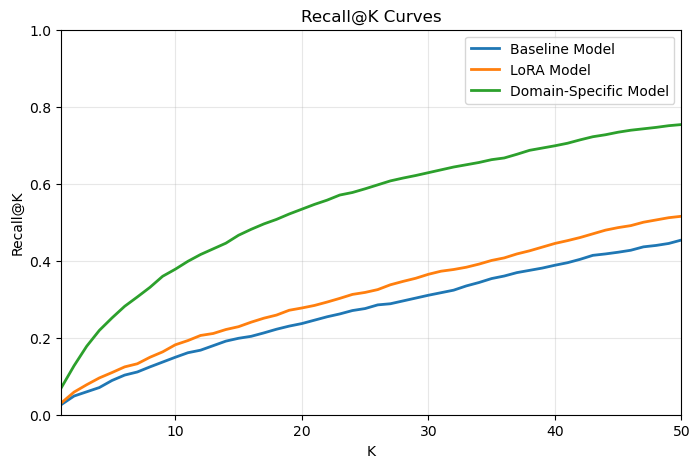

In [2]:
# Set device
if torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Using MPS (Apple Silicon GPU)")
else:
    device = torch.device("cpu")
    print("MPS not available, using CPU")

# Load the test dataset and images
test_set = "/Users/cyq/Desktop/Dissertation/Database/test_set.csv"
image_folder = "/Users/cyq/Desktop/Dissertation/Database/wikiart_images"

# Load the models
M1_path = "/Users/cyq/Desktop/Dissertation/Database/m1_clip_trained/final_model"
M2_path = "/Users/cyq/Desktop/Dissertation/Database/m2_lora_full/final_model"
M3_path = "/Users/cyq/Desktop/Dissertation/Database/m3_clip_trained/final_model"

# Create the output directory
output_dir = "/Users/cyq/Desktop/Dissertation/Database/test_outputs"
os.makedirs(output_dir, exist_ok = True)

# Define values of k
k_values = [1, 5, 10]

# Perform testing to compute the Top-K retrieval
m1_detail = run_model(test_set, image_folder, M1_path, device)
m2_detail = run_model(csv_path = test_set,
                      image_folder = image_folder,
                      model_path = M2_path,
                      device = device,
                      base_model_path = M1_path,
                      batch_size = 16)
m3_detail = run_model(test_set, image_folder, M3_path, device)

# Extract top-k results
m1_topk = m1_detail["topk"]
m2_topk = m2_detail["topk"]
m3_topk = m3_detail["topk"]

# Calculate the number of unique paintings from the test set
painting_test = pd.read_csv(test_set)
N = int(painting_test["PAINTING_ID"].nunique())


# Accuracy table
accuracy_tab = pd.DataFrame([
    {"Model": "Baseline Model", "R@1": m1_topk.get("R@1 Accuracy", np.nan),
                     "R@5": m1_topk.get("R@5 Accuracy", np.nan),
                     "R@10": m1_topk.get("R@10 Accuracy", np.nan)},
    {"Model": "LoRA Model", "R@1": m2_topk.get("R@1 Accuracy", np.nan),
                     "R@5": m2_topk.get("R@5 Accuracy", np.nan),
                     "R@10": m2_topk.get("R@10 Accuracy", np.nan)},
    {"Model": "Domain-Specific Model", "R@1": m3_topk.get("R@1 Accuracy", np.nan),
                     "R@5": m3_topk.get("R@5 Accuracy", np.nan),
                     "R@10": m3_topk.get("R@10 Accuracy", np.nan)},
])

# Print candidate set size
print(f"Number of candidate images N = {N}")

# Display tables
print("\nTable 1: Recall@K Accuracy")
display(accuracy_tab)

# Save results into csv
accuracy_tab.to_csv(os.path.join(output_dir, "accuracy_table.csv"), index = False)

# Define a function to compute recall values at different K values
def compute_recall_curve(gt_ranks, k_values):
    # Convert ground-truth ranks to numpy array
    ranks = np.asarray(gt_ranks, dtype = np.int64)
    total = len(ranks)
    recalls = []
    # Loop through each cutoff K and compute recall@K
    for K in k_values:
        recalls.append(float((ranks <= K).sum()) / float(total) if total > 0 else 0.0)
    return np.array(recalls, dtype = np.float32)

# Define K values for recall curve
k_curve = list(range(1, 51))

# Extract ground-truth rank lists for each model
m1_ranks = m1_detail["gt_ranks"]
m2_ranks = m2_detail["gt_ranks"]
m3_ranks = m3_detail["gt_ranks"]

# Compute recall curves for 3 models
recall_m1 = compute_recall_curve(m1_ranks, k_curve)
recall_m2 = compute_recall_curve(m2_ranks, k_curve)
recall_m3 = compute_recall_curve(m3_ranks, k_curve)

# Convert into a dataframe
recall_df = pd.DataFrame({
    "K": k_curve,
    "M1_Recall": recall_m1,
    "M2_Recall": recall_m2,
    "M3_Recall": recall_m3
})

# Save into csv
recall_csv_path = os.path.join(output_dir, "recall_at_k_curve.csv")
recall_df.to_csv(recall_csv_path, index = False)

# Visualise the recall@k curves
plt.figure(figsize = (8, 5))
plt.plot(k_curve, recall_m1, label = "Baseline Model", linewidth = 2)
plt.plot(k_curve, recall_m2, label = "LoRA Model", linewidth = 2)
plt.plot(k_curve, recall_m3, label = "Domain-Specific Model", linewidth = 2)
plt.xlabel("K")
plt.ylabel("Recall@K")
plt.ylim(0, 1.0)
plt.xlim(min(k_curve), max(k_curve))
plt.grid(True, alpha = 0.3)
plt.legend()
plt.title("Recall@K Curves")
recall_png_path = os.path.join(output_dir, "recall_at_k_curve.png")
plt.savefig(recall_png_path, dpi = 200, bbox_inches = "tight")
plt.show()
plt.close()

In [3]:
# -------------------- Sanity Check --------------------
# Check the test set size
print(f"\nSanity Check: Total {len(painting_test)} samples")

# Print R@1 and R@10 hit rates for each model
for model_name, topk_dict in zip(["M1", "M2", "M3"], [m1_topk, m2_topk, m3_topk]):
    gt_top1 = topk_dict.get("R@1 Accuracy", 0.0)
    gt_top10 = topk_dict.get("R@10 Accuracy", 0.0)
    print(f"{model_name}: R@1 hit rate = {gt_top1:.4f}, R@10 hit rate = {gt_top10:.4f}")

# Calculate the basic health signal on R@10 levels
top10_rates = [m1_topk.get("R@10 Accuracy", 0.0),
               m2_topk.get("R@10 Accuracy", 0.0),
               m3_topk.get("R@10 Accuracy", 0.0)]

# Analyse the R@10 accuracy patterns
if max(top10_rates) < 0.05:
    print("All models have very low R@10 accuracy.")
elif len(set([round(x, 4) for x in top10_rates])) == 1:
    print("All models have similar R@10 accuracy.")
else:
    print("All models show different R@10 accuracy.")


Sanity Check: Total 1360 samples
M1: R@1 hit rate = 0.0000, R@10 hit rate = 0.0000
M2: R@1 hit rate = 0.0000, R@10 hit rate = 0.0000
M3: R@1 hit rate = 0.0000, R@10 hit rate = 0.0000
All models have very low R@10 accuracy.


,M1,M2,M3
0,155.0,101.0,39.0
1,114.0,97.0,117.0
2,185.0,102.0,98.0
3,202.0,153.0,89.0
4,153.0,126.0,85.0
...,...,...,...
1355,44.0,4.0,56.0
1356,92.0,48.0,25.0
1357,73.0,37.0,94.0
1358,30.0,26.0,75.0



Table: MRR and Median Rank


,Model,MRR,Median Rank
0,M1,0.0737,58.0
1,M2,0.0865,47.5
2,M3,0.1699,18.0


Saved: /Users/cyq/Desktop/Dissertation/Database/test_outputs/mrr_median_metrics.csv


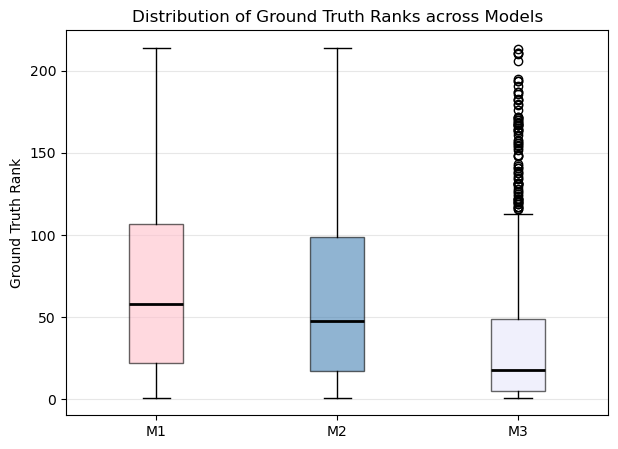

In [4]:
# -------------------- Extended Metrics --------------------
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

# Define the saving path
rank_root = Path(globals().get("output_dir", ".")) / "DeltaRank"
rank_root.mkdir(parents = True, exist_ok = True)

# Align all the models to the same set of samples
paired = pd.DataFrame({
    "M1": pd.Series(m1_detail["gt_ranks"], dtype = "float"),
    "M2": pd.Series(m2_detail["gt_ranks"], dtype = "float"),
    "M3": pd.Series(m3_detail["gt_ranks"], dtype = "float"),
}).dropna()
display(paired)

# Convert results into dataframe and save it
rank_df = paired.describe().round(2)
rank_df.to_csv(os.path.join(rank_root, "gt_rank_summary.csv"))

# Define a function to calculate the MRR and median rank
def compute_mrr_median(gt_ranks):
    # Convert input into numpy array of float
    r = np.asarray(gt_ranks, dtype = float)
    # Remove NaN
    r = r[~ np.isnan(r)]
    # If no valid ranks remain, return NaN
    if r.size == 0:
        return np.nan, np.nan
    # Compute MRR
    mrr = float(np.mean(1.0 / r))
    # Compute median rank
    median_rank = float(np.median(r))
    return mrr, median_rank

# Create an empty list to store necessary metrics
rows = []

# Loop through models to compute MRR and median rank
for name, detail in [("M1", m1_detail), ("M2", m2_detail), ("M3", m3_detail)]:
    # Compute MRR and median rank
    mrr, median_rank = compute_mrr_median(detail["gt_ranks"])
    # Add results into the list
    rows.append({"Model": name,
                 "MRR": mrr,
                 "Median Rank": median_rank})

# Convert to DataFrame
mrr_median_tab = pd.DataFrame(rows)
mrr_median_tab["MRR"] = mrr_median_tab["MRR"].round(4) # Keep 4 decimal places
mrr_median_tab["Median Rank"] = mrr_median_tab["Median Rank"].round(1) # Keep 1 decimal place

# Print results
print("\nTable: MRR and Median Rank")
display(mrr_median_tab)

# Save results
mrr_csv = os.path.join(output_dir, "mrr_median_metrics.csv")
mrr_median_tab.to_csv(mrr_csv, index = False)
print("Saved:", mrr_csv)

# Plot the boxplot to compare rank distributions across models
plt.figure(figsize = (7, 5))
box = plt.boxplot(
    [paired["M1"], paired["M2"], paired["M3"]],
    labels = ["M1", "M2", "M3"],
    patch_artist = True,
    showfliers = True,
    medianprops = dict(color = "black", linewidth = 2)
)
colors = ["pink", "steelblue", "lavender"] # Define the body colours
for patch, color in zip(box["boxes"], colors):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)
plt.ylabel("Ground Truth Rank")
plt.title("Distribution of Ground Truth Ranks across Models")
plt.grid(axis = "y", alpha = 0.3)

# Save and display the plots
out_path = os.path.join(rank_root, "gt_rank_boxplot.png")
plt.savefig(out_path, dpi = 300, bbox_inches = "tight")
plt.show()


M1: 

samples = 1360, embed_dim = 512
Trying torch.pca_lowrank on device: mps
The operator 'aten::linalg_qr.out' is not currently implemented for the MPS device. If you want this op to be considered for addition please comment on https://github.com/pytorch/pytorch/issues/141287 and mention use-case, that resulted in missing op as well as commit hash e2d141dbde55c2a4370fac5165b0561b6af4798b. As a temporary fix, you can set the environment variable `PYTORCH_ENABLE_MPS_FALLBACK=1` to use the CPU as a fallback for this op. WARNING: this will be slower than running natively on MPS. : fallback to sklearn.PCA
Explained variance ratio (sum): 0.973
Searching K in [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] ...
M1 Saved K sweep table: /Users/cyq/Desktop/Dissertation/Database/test_outputs/embed_cluster_outputs/M1/M1_kmeans_k_search_scores.csv
    K     inertia  silhouette  calinski_harabasz  davies_bouldin  rank_sum
0   2  277.941711    0.122112         188.774917        2.553622      13.0
1   3  254.3

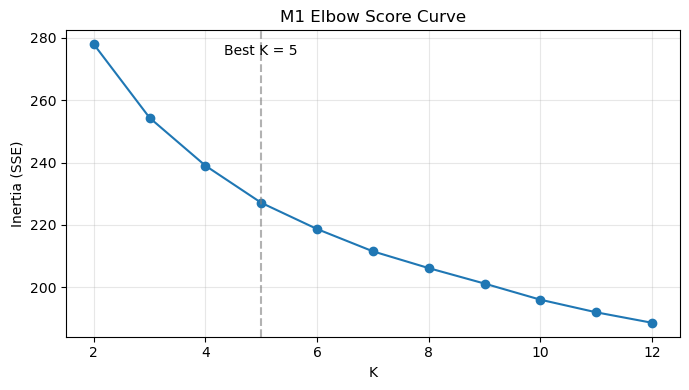

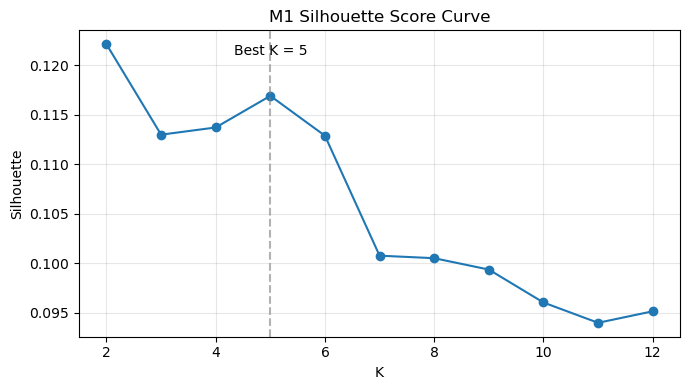

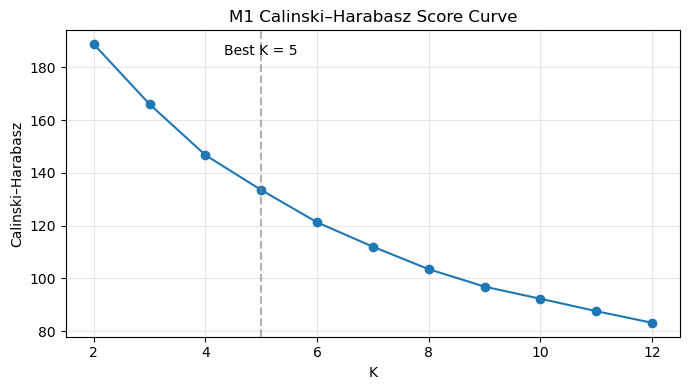

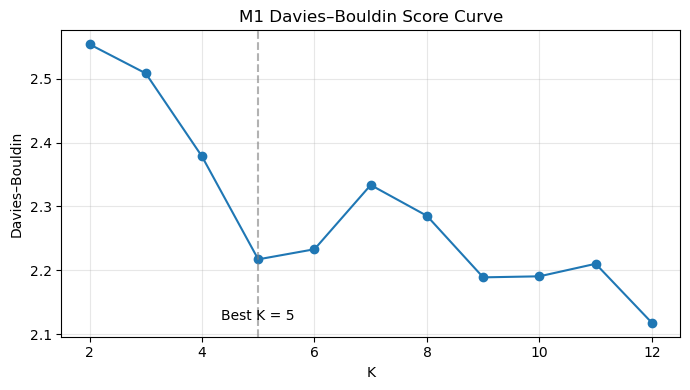

M1 Best K = 5: Cluster 0: 308 (22.6%)
M1 Best K = 5: Cluster 1: 358 (26.3%)
M1 Best K = 5: Cluster 2: 282 (20.7%)
M1 Best K = 5: Cluster 3: 143 (10.5%)
M1 Best K = 5: Cluster 4: 269 (19.8%)


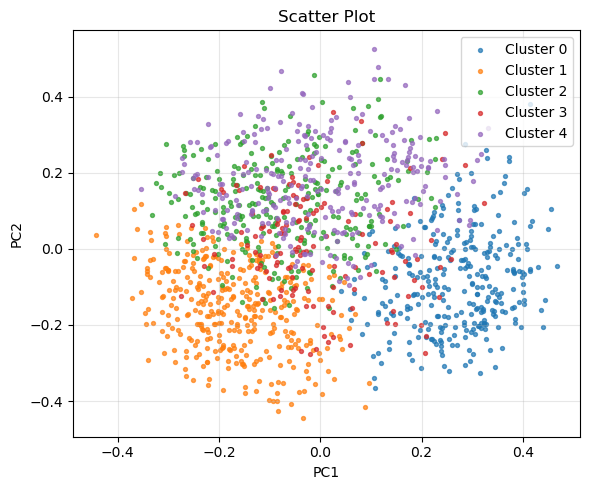

 Cluster  Sample Size Model 1 Model 2 Model 3 Best Model
       0          308    56.3    52.2    28.9         M3
       1          358    69.3    60.6    33.7         M3
       2          282    85.0    74.1    45.2         M3
       3          143    66.7    58.5    21.4         M3
       4          269    77.8    69.2    40.9         M3
   Cluster  Size  M1_Avg_Rank  M2_Avg_Rank  M3_Avg_Rank  M2_Improvement_vs_M1  \
0        0   308    56.292208    52.168831    28.948052              4.123377   
1        1   358    69.287709    60.567039    33.743017              8.720670   
2        2   282    84.985816    74.106383    45.212766             10.879433   
3        3   143    66.741259    58.482517    21.405594              8.258741   
4        4   269    77.795539    69.234201    40.855019              8.561338   

   M3_Improvement_vs_M1 Best_Model  Best_Rank  
0             27.344156         M3  28.948052  
1             35.544693         M3  33.743017  
2             39.773050    

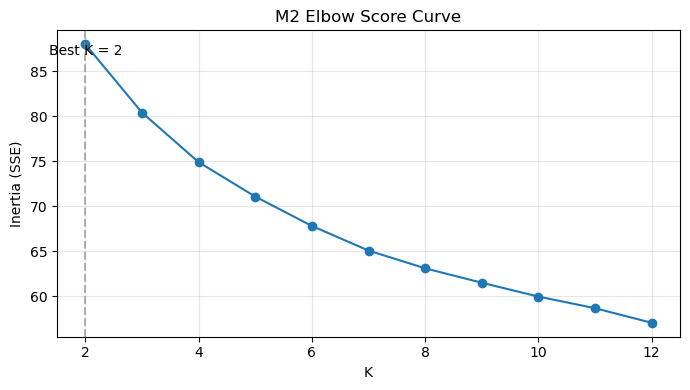

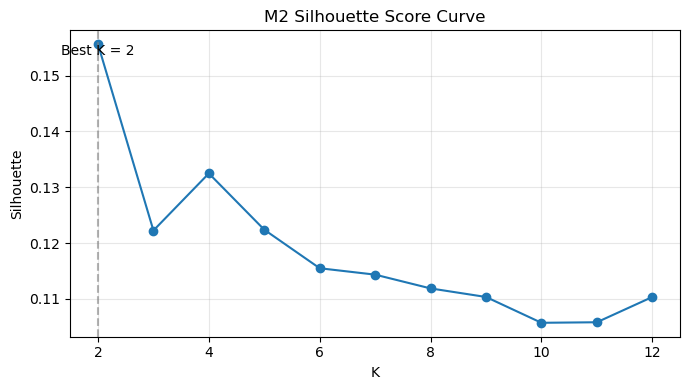

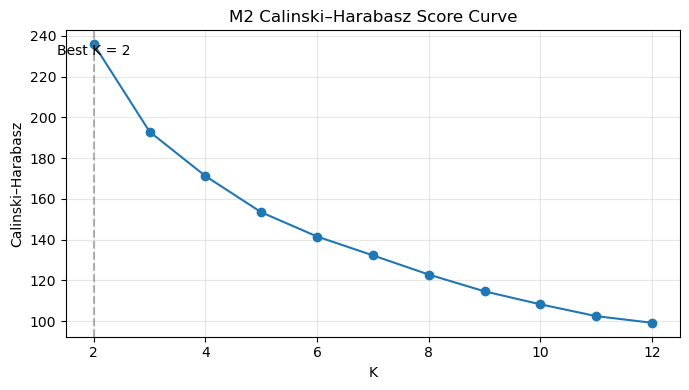

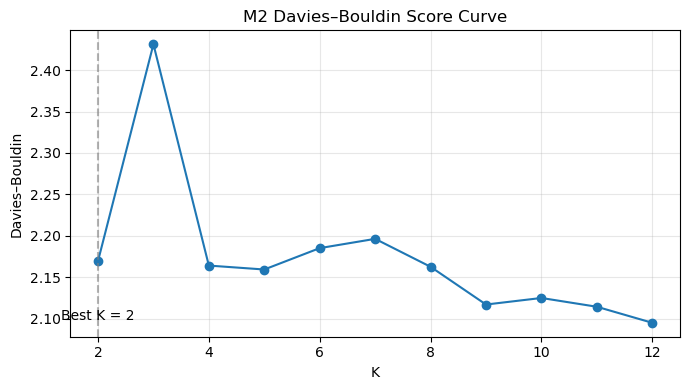

M2 Best K = 2: Cluster 0: 438 (32.2%)
M2 Best K = 2: Cluster 1: 922 (67.8%)


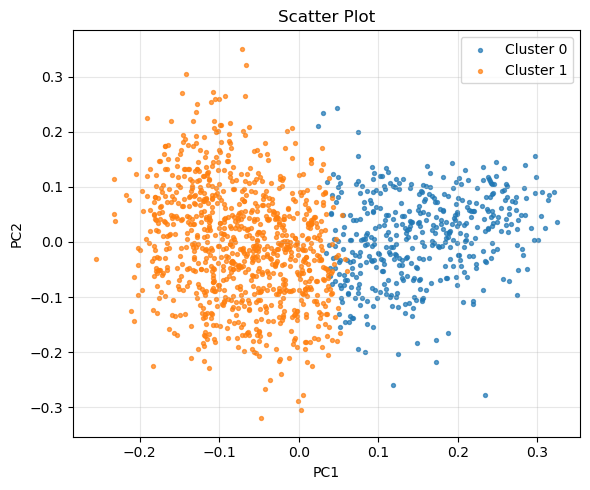

 Cluster  Sample Size Model 1 Model 2 Model 3 Best Model
       0          438    60.2    54.1    30.9         M3
       1          922    76.1    67.2    37.2         M3
   Cluster  Size  M1_Avg_Rank  M2_Avg_Rank  M3_Avg_Rank  M2_Improvement_vs_M1  \
0        0   438    60.221461    54.136986    30.901826              6.084475   
1        1   922    76.142082    67.162690    37.160521              8.979393   

   M3_Improvement_vs_M1 Best_Model  Best_Rank  
0             29.319635         M3  30.901826  
1             38.981562         M3  37.160521  
   Cluster  TopN                                       Top_Keywords
0        0    10  river, town, lake, trees, sea, boat, buildings...
1        1    10  eyes, hair, face, girl, wearing, naked, woman,...

M3: 

samples = 1360, embed_dim = 512
Trying torch.pca_lowrank on device: mps
The operator 'aten::linalg_qr.out' is not currently implemented for the MPS device. If you want this op to be considered for addition please comment on https:

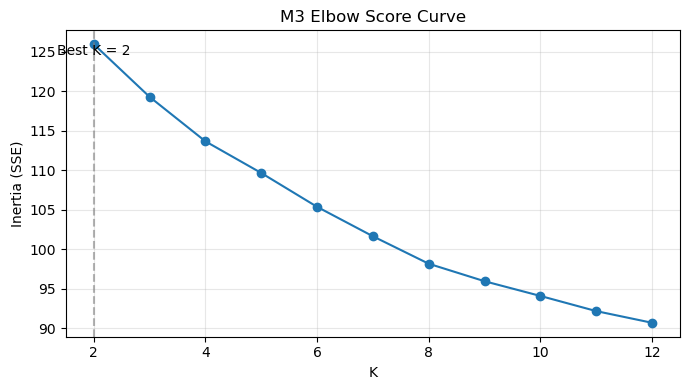

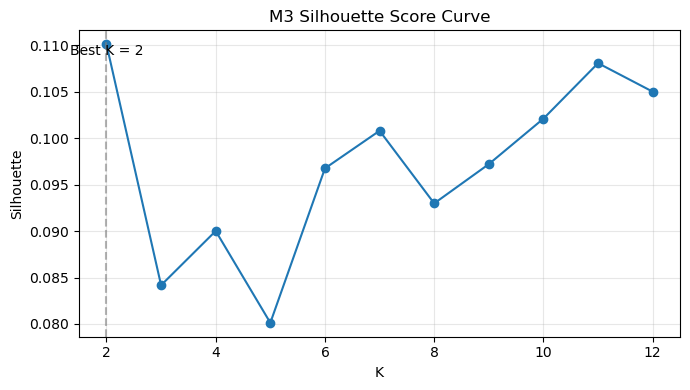

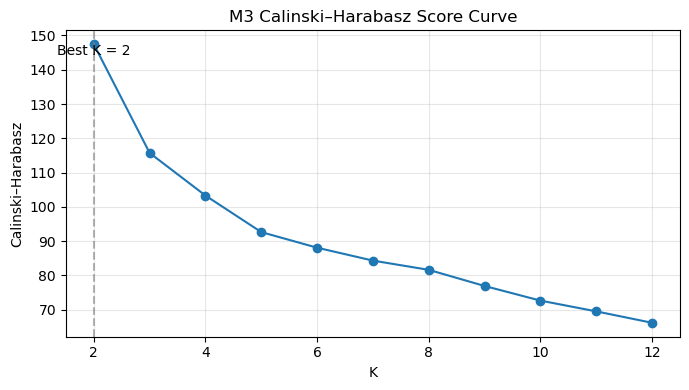

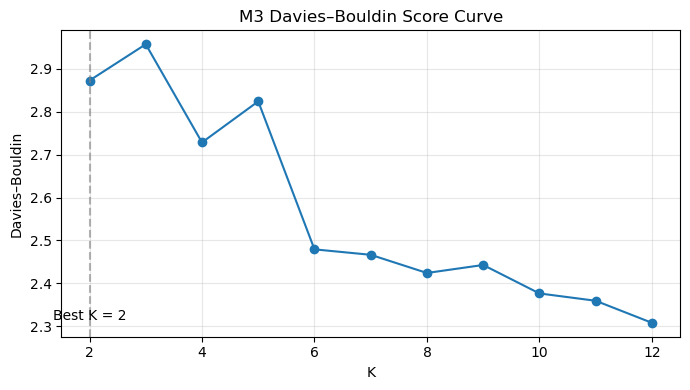

M3 Best K = 2: Cluster 0: 488 (35.9%)
M3 Best K = 2: Cluster 1: 872 (64.1%)


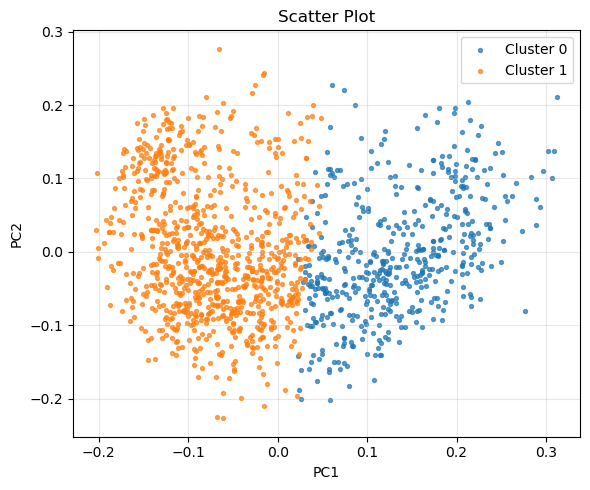

 Cluster  Sample Size Model 1 Model 2 Model 3 Best Model
       0          488    61.7    56.5    31.0         M3
       1          872    76.2    66.6    37.5         M3
   Cluster  Size  M1_Avg_Rank  M2_Avg_Rank  M3_Avg_Rank  M2_Improvement_vs_M1  \
0        0   488    61.659836    56.463115    31.022541              5.196721   
1        1   872    76.250000    66.607798    37.451835              9.642202   

   M3_Improvement_vs_M1 Best_Model  Best_Rank  
0             30.637295         M3  31.022541  
1             38.798165         M3  37.451835  
   Cluster  TopN                                       Top_Keywords
0        0    10  trees, river, town, lake, water, walking, sea,...
1        1    10  eyes, woman, hair, face, man, expression, girl...


In [5]:
# -------------------- PCA and KMeans in Text-only Embedding --------------------
import os
import torch
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.decomposition import PCA as SKPCA
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize


# Set environment threads to avoid overload
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["VECLIB_MAXIMUM_THREADS"] = "1"
os.environ["NUMEXPR_NUM_THREADS"] = "1"
warnings.filterwarnings("ignore", category = FutureWarning)

# Set random seed for reproducibility
np.random.seed(985)
torch.manual_seed(985)

# Define the output directory
save_root = Path(globals().get("output_dir", ".")) / "embed_cluster_outputs"
save_root.mkdir(parents = True, exist_ok = True)

# Set the parameters
k_min = 2 # Set minimun number of clusters
k_max_0 = 12 # Set maximum number of clusters
use_pca = True # Whether to use PCA
n_pca = 50 # Set the number of PCA components
n_init = 10 # Set the KMeans initialisations
point_size = 8 # Set the scatter plot point size

# Define a function to convert torch tensor to numpy array
def to_numpy(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy() # Move to CPU and detach from computation graph
    return np.asarray(x)

# Define a function to perform Principal Component Analysis
def pca_torch(X_np, n_components, seed = 985, device = None):
    # Convert numpy array to torch tensor
    X_t = torch.from_numpy(X_np)
    # Select device
    if device is None:
        device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
    X_t = X_t.to(device)
    # Center the data
    mean = X_t.mean(dim = 0, keepdim = True)
    Xc = X_t - mean
    # Compute the low-rank PCA
    U, S, V = torch.pca_lowrank(Xc, q = n_components, center = False)
    Z = Xc @ V[:, :n_components]
    return Z.detach().cpu().numpy()

# Define a function to perform Principal Component Analysis by using KMeans
def pca_sklearn(X_np, n_components):
    # Initialize PCA
    pca = SKPCA(n_components = n_components, svd_solver = "randomized", random_state = 985)
    # Transform data into principal components
    Z = pca.fit_transform(X_np)
    # Print explained variance ratio for information
    evr_sum = getattr(pca, "explained_variance_ratio_", np.array([])).sum()
    print(f"Explained variance ratio (sum): {evr_sum:.3f}")
    return Z

# Define a function to plot clusters in 2D space
def plot_clusters(points2d, labels, title, save_path, point_size = 8):
    # Create a scatter plot
    plt.figure(figsize = (6, 5))
    K = int(np.max(labels) + 1) # Define K as the number of clusters
    cmap = plt.get_cmap("tab10")
    # Loop through clusters to plot scatter plots
    for k in range(K):
        mask = (labels == k)
        plt.scatter(points2d[mask, 0],
                    points2d[mask, 1],
                    s = point_size,
                    alpha = 0.7,
                    label = f"Cluster {k}",
                    c = np.array([cmap(k)]))
    plt.title(title)
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend(loc = "best", frameon = True)
    plt.grid(True, alpha = 0.3)
    plt.tight_layout()
    plt.savefig(save_path, dpi = 160)
    plt.show()

# Define a function to get keywords in each cluster by using log-odds
def cluster_keywords(utterances, cluster_labels, top_n = 10):
    # Build a count vectorizer
    cv = CountVectorizer(stop_words = "english", ngram_range = (1, 3), min_df = 3, max_df = 0.7)
    # Convert utterances to count matrix
    X_cnt = cv.fit_transform(utterances)
    # Get vocabulary list
    vocab = np.array(cv.get_feature_names_out())
    # Define a function to find keywords for each cluster
    def one_cluster(cid):
        # Get indices of utterances inside and outside this cluster
        idx_c = np.where(cluster_labels == cid)[0]
        idx_o = np.where(cluster_labels != cid)[0]
        # If no samples, return empty list
        if len(idx_c) == 0 or len(idx_o) == 0:
            return []
        # Count word frequencies in cluster and outside
        fc = np.asarray(X_cnt[idx_c].sum(axis = 0)).ravel().astype(np.float64)
        fo = np.asarray(X_cnt[idx_o].sum(axis = 0)).ravel().astype(np.float64)
        # Add smoothing
        fc += 1.0
        fo += 1.0
        # Convert to probabilities
        pc = fc / fc.sum()
        po = fo / fo.sum()
        # Compute log-odds score
        logodds = np.log(pc / (1 - pc + 1e-12)) - np.log(po / (1 - po + 1e-12))
        # Pick top-N words with highest log-odds
        top = np.argsort(logodds)[-top_n:][::-1]
        return list(zip(vocab[top], logodds[top]))
    # Loop through all clusters and collect keywords
    all_keywords = [] # Create an empty list to store keywords
    for cid in range(int(np.max(cluster_labels)) + 1):
        all_keywords.append((cid, one_cluster(cid)))
    return all_keywords

# Define a function to get representative utterances
def representatives(X_pca, labels, centers, utterances, top_m = 10):
    # Create an empty list to store all representative utterances
    reps_all = []
    # Loop through clusters to find representative utterances
    for cid in range(int(np.max(labels)) + 1):
        # Find indices of samples belonging to this cluster
        idx = np.where(labels == cid)[0]
        # If the cluster is empty, skip it
        if len(idx) == 0: 
            continue
        # Compute the cosine similarity between samples and the cluster centre
        sims = cosine_similarity(X_pca[idx], centers[cid][None, :]).ravel()
        # Sort indices by similarity in descending order
        order = np.argsort(sims)[:: -1][:top_m]
        # Pick the top-M closest samples
        picked = idx[order]
        # Loop through selected samples and record their informations
        for j, (rid, sim) in enumerate(zip(picked, sims[order]), 1):
            reps_all.append({
                "Cluster": cid,
                "RankInCluster": j,
                "Index": int(rid),
                "Utterance": utterances[rid],
                "CenterSim": float(sim)
            })
    return pd.DataFrame(reps_all)

# Define a function to evaluate cluster performance by average rank
def cluster_rankperf(labels, ranks_m1, ranks_m2, ranks_m3):
    # Create en empty list to store rank performance
    rows = []
    # Loop through clusters to compute the ranks for each utterance
    for cid in range(int(np.max(labels)) + 1):
        # Get indices of samples belonging to this cluster
        idx = np.where(labels == cid)[0]
        # If the cluster is empty, skip it
        if len(idx) == 0:
            continue
        # Compute average rank for each model in this cluster
        m1 = float(np.nanmean([ranks_m1[i] for i in idx]))
        m2 = float(np.nanmean([ranks_m2[i] for i in idx]))
        m3 = float(np.nanmean([ranks_m3[i] for i in idx]))
        # Add performance information into the list
        rows.append({
            "Cluster": cid, "Size": len(idx),
            "M1_Avg_Rank": m1,
            "M2_Avg_Rank": m2,
            "M3_Avg_Rank": m3,
            "M2_Improvement_vs_M1": (m1 - m2),
            "M3_Improvement_vs_M1": (m1 - m3),
            "Best_Model": ["M1", "M2", "M3"][np.argmin([m1, m2, m3])],
            "Best_Rank": min(m1, m2, m3)
        })
    return pd.DataFrame(rows)

# Define a function to run clustering for each model
def run_for_model(model_detail, model_name,
                  ranks_all,
                  save_root = save_root,
                  use_pca = use_pca, n_pca = n_pca,
                  kmin = k_min, kmax0 = k_max_0, n_init = n_init,
                  point_size = point_size):
    print(f"\n{model_name}: \n")
    # Convert features to numpy
    X = to_numpy(model_detail["text_feats"]).astype(np.float32, copy = False)
    assert X.ndim == 2
    n_samples, _ = X.shape # Get number of samples and feature dim
    X = normalize(X, norm = "l2")
    # Load utterances
    testing = model_detail["data"].reset_index(drop = True)
    utters = testing["UTTERANCE"].astype(str).tolist() # Convert to list
    # Align sizes if mismatch
    if len(utters) != n_samples:
        m = min(len(utters), n_samples)
        print(f"Warning for length mismatch: truncating to {m}")
        X = X[:m]
        testing = testing.iloc[:m].reset_index(drop = True)
        utters = utters[:m]
    # Drop rows with invalid values
    mask_finite = np.isfinite(X).all(axis = 1)
    if not mask_finite.all():
        bad = int((~ mask_finite).sum()) # Count for bad rows
        print(f"Drop {bad} rows with NaN/Inf.")
        X = X[mask_finite]
        testing = testing[mask_finite].reset_index(drop = True)
        # Filter texts
        utters = [u for i,u in enumerate(utters) if mask_finite[i]]
        # Align ranks arrays to the filtered rows
        ranks_all = tuple(np.asarray(r)[mask_finite].tolist() for r in ranks_all)
    # Unpack ranks for three models
    m1_r, m2_r, m3_r = ranks_all
    assert len(m1_r) == len(utters) == X.shape[0]
    print(f"samples = {len(utters)}, embed_dim = {X.shape[1]}")
    # Apply PCA
    max_pc = int(min(n_pca, X.shape[0] - 1, X.shape[1])) # Define the max pricipal components
    # If the max principal components less than 2, raise error
    if max_pc < 2:
        raise ValueError(f"Not enough samples/features for PCA: {X.shape}")
    # If torch PCA is available, perform it.
    if use_pca:
        try:
            dev = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
            print(f"Trying torch.pca_lowrank on device: {dev.type}")
            # Try torch PCA
            X_pca = pca_torch(X, max_pc, device = dev)
        except Exception as e:
            print(f"{e} : fallback to sklearn.PCA")
            X_pca = None
    else:
        X_pca = None
    # If torch PCA not used or failed, run sklearn PCA.
    if X_pca is None:
        X_pca = pca_sklearn(X, max_pc)
    # Search for best K automatically
    K_max = min(kmax0, len(utters) - 1) # Define the upper bound
    k_list = list(range(kmin, K_max + 1)) # List to contain K candidates
    print(f"Searching K in {k_list} ...")
    # Define an empty list to store results
    rows = []
    # Loop through k_list to find the best K and calculate related metrics
    for K in k_list:
        km = KMeans(n_clusters = K, random_state = 985, n_init = n_init) # Initialise kmeans
        labels = km.fit_predict(X_pca)
        # Try to compute Silhouette score
        try:
            sil = silhouette_score(X_pca, labels)
        except Exception:
            sil = np.nan
        # Try to compute Calinski Harabasz score
        try:
            ch = calinski_harabasz_score(X_pca, labels)
        except Exception:
            ch = np.nan
        # Try to compute Davies Bouldin score
        try:
            db = davies_bouldin_score(X_pca, labels)
        except Exception:
            db = np.nan
        # Add results in the list
        rows.append({"K": K,
                     "inertia": km.inertia_,
                     "silhouette": sil,
                     "calinski_harabasz": ch,
                     "davies_bouldin": db})
    # Convert to DataFrame for ranking
    res_df = pd.DataFrame(rows)
    # Combine ranks across metrics
    res_df["rank_sum"] = (- res_df["silhouette"]).rank(method = "min") \
                       + (- res_df["calinski_harabasz"]).rank(method = "min") \
                       + ( res_df["davies_bouldin"]).rank(method = "min")
    # Choose the best row
    auto_row = res_df.loc[res_df["rank_sum"].idxmin()]
    # Get the best K
    K_best_auto = int(auto_row["K"])
    # Save K results and print path
    save_dir = save_root / model_name
    save_dir.mkdir(parents = True, exist_ok = True)
    scores_path = save_dir / f"{model_name}_kmeans_k_search_scores.csv"
    res_df.sort_values(["rank_sum", "K"], na_position = "last").to_csv(scores_path, index = False)
    print(f"{model_name} Saved K sweep table: {scores_path}")
    print(res_df.head(10))
    # Plot Elbow curve
    plt.figure(figsize = (7, 4)) # Set figure
    plt.plot(res_df["K"], res_df["inertia"], marker = "o")
    plt.axvline(K_best_auto, ls = "--", color = "gray", alpha = 0.6) # Mark the best K
    plt.text(K_best_auto, res_df["inertia"].max(), f"Best K = {K_best_auto}", 
             ha = "center", va = "top")
    plt.xlabel("K")
    plt.ylabel("Inertia (SSE)")
    plt.title(f"{model_name} Elbow Score Curve")
    plt.grid(True, alpha = 0.3)
    plt.tight_layout()
    plt.savefig(save_dir/f"{model_name}_elbow.png", dpi = 160)
    plt.show()
    # Plot Silhouette curve
    plt.figure(figsize = (7, 4))
    plt.plot(res_df["K"], res_df["silhouette"], marker = "o")
    plt.axvline(K_best_auto, ls = "--", color = "gray", alpha = 0.6)
    plt.text(K_best_auto, res_df["silhouette"].max(), f"Best K = {K_best_auto}",
             ha = "center", va = "top")
    plt.xlabel("K")
    plt.ylabel("Silhouette")
    plt.title(f"{model_name} Silhouette Score Curve")
    plt.grid(True, alpha = 0.3)
    plt.tight_layout()
    plt.savefig(save_dir/f"{model_name}_silhouette.png", dpi = 160)
    plt.show()
    # Plot Calinski–Harabasz curve
    plt.figure(figsize=(7, 4))
    plt.plot(res_df["K"], res_df["calinski_harabasz"], marker = "o")
    plt.axvline(K_best_auto, ls = "--", color = "gray", alpha = 0.6)
    plt.text(K_best_auto, res_df["calinski_harabasz"].max(), f"Best K = {K_best_auto}",
             ha = "center", va = "top")
    plt.xlabel("K")
    plt.ylabel("Calinski–Harabasz")
    plt.title(f"{model_name} Calinski–Harabasz Score Curve")
    plt.grid(True, alpha = 0.3)
    plt.tight_layout()
    plt.savefig(save_dir/f"{model_name}_calinski_harabasz.png", dpi = 160)
    plt.show()
    # Plot Davies–Bouldin curve
    plt.figure(figsize = (7, 4))
    plt.plot(res_df["K"], res_df["davies_bouldin"], marker = "o")
    plt.axvline(K_best_auto, ls = "--", color = "gray", alpha = 0.6)
    plt.text(K_best_auto, res_df["davies_bouldin"].min(), f"Best K = {K_best_auto}",
             ha = "center", va = "bottom")
    plt.xlabel("K")
    plt.ylabel("Davies–Bouldin")
    plt.title(f"{model_name} Davies–Bouldin Score Curve")
    plt.grid(True, alpha = 0.3)
    plt.tight_layout()
    plt.savefig(save_dir/f"{model_name}_davies_bouldin.png", dpi = 160)
    plt.show()
    # Fit final KMeans and visualize 2D PCA
    pts2d_auto = SKPCA(n_components = 2, svd_solver = "randomized", random_state = 985).fit_transform(X)
    kmeans_auto = KMeans(n_clusters = K_best_auto, random_state = 985, n_init = n_init)
    labels_auto = kmeans_auto.fit_predict(X_pca)
    # Compute and print cluster sizes
    sizes_auto = [int((labels_auto == i).sum()) for i in range(K_best_auto)]
    for i, n_i in enumerate(sizes_auto):
        print(f"{model_name} Best K = {K_best_auto}: Cluster {i}: {n_i} ({n_i/len(utters):.1%})")
    # Visualise the scatter plot
    plot_clusters(
        pts2d_auto, labels_auto,
        title = f"Scatter Plot",
        save_path = save_dir/f"{model_name}_pca2_scatter_autoK_{K_best_auto}.png",
        point_size = point_size
    )
    # Use the auto-K labels for downstream statistics
    labels = labels_auto
    centers = kmeans_auto.cluster_centers_
    # Save cluster assignment back into the original table
    out_df = testing.reset_index(drop = False).rename(columns = {"index": "utt_idx"})
    out_df["Cluster"] = labels
    out_df = out_df.drop_duplicates(subset = "utt_idx", keep = "first")
    out_df.to_csv(save_dir / f"{model_name}_with_clusters.csv", index = False)
    # Evaluate performance by ranks
    perf_df = cluster_rankperf(labels, * ranks_all)
    pub = perf_df.copy()
    # Keep results with 1 decimal place
    pub["M1_Avg_Rank"] = pub["M1_Avg_Rank"].round(1)
    pub["M2_Avg_Rank"] = pub["M2_Avg_Rank"].round(1)
    pub["M3_Avg_Rank"] = pub["M3_Avg_Rank"].round(1)
    pub["M2_Improvement_vs_M1"] = pub["M2_Improvement_vs_M1"].round(1)
    pub["M3_Improvement_vs_M1"] = pub["M3_Improvement_vs_M1"].round(1)
    # Build display columns for Model1 / Model2 / Model3 with improvements
    pub["Model 1"] = pub["M1_Avg_Rank"].map(lambda v: f"{v:.1f}")
    pub["Model 2"] = pub["M2_Avg_Rank"].map(lambda v: f"{v:.1f}")
    pub["Model 3"] = pub["M3_Avg_Rank"].map(lambda v: f"{v:.1f}")
    # Reorder and rename columns
    pub["Sample Size"] = pub["Size"]
    pub = pub[["Cluster", "Sample Size", "Model 1", "Model 2", "Model 3", "Best_Model"]]
    pub = pub.rename(columns = {"Best_Model": "Best Model"})
    # Save output as csv
    pub_path = save_dir/f"{model_name}_cluster_perf_for_paper.csv"
    pub.to_csv(pub_path, index = False)
    print(pub.to_string(index = False))
    perf_df.to_csv(save_dir/f"{model_name}_cluster_performance_summary.csv", index = False)
    print(perf_df)
    # Set the number of keywords to keep for each cluster
    top_n = 10
    # Extract keywords for each cluster by using log-odds
    kw = cluster_keywords(utters, labels, top_n = top_n)
    # Save keywords into csv
    kw_rows = []
    for cid, tops in kw:
        words = [w for w, _ in tops][:top_n]
        kw_rows.append({"Cluster": int(cid), "TopN": top_n, "Top_Keywords": ", ".join(words)})
    # Save the keywords table to csv
    kw_df = pd.DataFrame(kw_rows).sort_values("Cluster").reset_index(drop = True)
    kw_csv = save_dir / f"{model_name}_cluster_keywords_top{top_n}.csv"
    kw_df.to_csv(kw_csv, index = False)
    print(kw_df)
    # Find the representative utterances
    reps_df = representatives(X_pca, labels, centers, utters, top_m = 10)
    reps_df.to_csv(save_dir/f"{model_name}_cluster_representatives_top10.csv", index = False)
    # Combine and save the top-1 representative for each cluster
    top1 = reps_df.sort_values(["Cluster","RankInCluster"]).groupby("Cluster").head(1)
    top1[["Cluster","Index","Utterance","CenterSim"]].to_csv(save_dir/f"{model_name}_cluster_representatives_top1.csv", index = False)
    return {
        "K_best_auto": K_best_auto,
        "labels": labels,
        "perf_df": perf_df,
        "keywords": kw_rows,
        "reps_top1": top1
    }

# Define a function to converttorch tensor into a python list
def to_list(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy().tolist()
    return list(x)

# Convert the ground truth ranks for each model to lists
m1_ranks_all = to_list(m1_detail["gt_ranks"])
m2_ranks_all = to_list(m2_detail["gt_ranks"])
m3_ranks_all = to_list(m3_detail["gt_ranks"])
ranks_all_tuple = (m1_ranks_all, m2_ranks_all, m3_ranks_all)

# Loop through 3 models to run the full cluster analysis
cluster_results = {}
for (detail, name) in [(m1_detail, "M1"), (m2_detail, "M2"), (m3_detail, "M3")]:
    cluster_results[name] = run_for_model(
        model_detail = detail,
        model_name = name,
        ranks_all = ranks_all_tuple,
        save_root = save_root,
        use_pca = use_pca,
        n_pca = n_pca,
        kmin = k_min,
        kmax0 = k_max_0,
        n_init = n_init,
        point_size = point_size
    )

# Loop through to combine all results and print them
combo_rows = [] # Create an empty list to store combined results
for name in ["M1", "M2", "M3"]:
    p = save_root / name / f"{name}_kmeans_k_search_scores.csv"
    if p.exists():
        dfk = pd.read_csv(p)
        dfk.insert(0, "Model", name)
        combo_rows.append(dfk)
if combo_rows:
    combo = pd.concat(combo_rows, ignore_index = True)
    combo_path = save_root / "ALL_models_k_sweep_scores.csv"
    combo.to_csv(combo_path, index = False)

In [6]:
# -------------------- Example Utterance --------------------
import os
import json
import math
import torch
import warnings
import numpy as np
import pandas as pd
import torch.nn.functional as F
from tqdm import tqdm
from pathlib import Path
from PIL import Image, ImageOps, ImageDraw
from torch.utils.data import Dataset
from IPython.display import display, Markdown
from transformers import CLIPProcessor, CLIPModel
from peft import LoraConfig, get_peft_model, set_peft_model_state_dict

# Ignore warnings
warnings.filterwarnings("ignore", category = UserWarning)

# Define a function to select device
def select_device(auto_mps = True):
    if auto_mps and torch.backends.mps.is_available():
        return torch.device("mps")
    return "cpu"

# Define a function to create a directory if it does not exist
def ensure_dir(p):
    Path(p).mkdir(parents = True, exist_ok = True)

# Define a function to load an image
def load_image(path, preserve_aspect = True):
    try:
        # Open image and convert to RGB
        img = Image.open(path).convert("RGB")
        return img if preserve_aspect else img.resize((256, 256))
    except Exception:
        return Image.new("RGB", (256, 256), (220, 220, 220)) # If loading fails, return a gray placeholder image

# Define a dataset class for handling text data
class TextDataset(Dataset):
    # Initialize the dataset with a dataframe and target text column
    def __init__(self, df, text_col):
        self.texts = df[text_col].astype(str).tolist()
    # Return the total number of samples in the dataset
    def __len__(self): 
        return len(self.texts)
    # Retrieve the text at the given index
    def __getitem__(self, i): 
        return self.texts[i]

# Define a dataset class for handling image paths
class ImageDataset(Dataset):
    # Initialize the dataset with a dataframe and image path column
    def __init__(self, uniq_df, path_col):
        self.paths = uniq_df[path_col].astype(str).tolist()
    # Return the total number of image paths in the dataset
    def __len__(self): 
        return len(self.paths)
    # Retrieve the image path at the given index
    def __getitem__(self, i): 
        return self.paths[i]

# Define a function to load a CLIP model
def load_clip(model_path: str,
                  hf_backbone: str = "openai/clip-vit-base-patch32") -> CLIPModel:
    p = Path(model_path)
    # Load model directly if given a HuggingFace-style directory with config.json
    if p.is_dir() and (p / "config.json").exists():
        print(f"HF directory: {p}")
        return CLIPModel.from_pretrained(str(p))
    print(f"Checkpoint: {p}")
    base = CLIPModel.from_pretrained(hf_backbone) # Load base CLIP backbone
    ckpt = torch.load(str(p), map_location = "cpu") # Load checkpoint into CPU memory
    state = ckpt.get("model_state_dict", ckpt) # Extract state dict
    keys = list(state.keys()) # Collect parameter keys from the checkpoint
    # Check if the checkpoint contains LoRA parameters
    has_lora = any(("lora_" in k) or ("A" in k and "lora" in k.lower()) for k in keys)
    # If checkpoint does not contain LoRA params, load into base CLIP
    if not has_lora:
        missing, unexpected = base.load_state_dict(state, strict = False)
        print(f"load_state_dict(strict = False): missing = {len(missing)}, unexpected = {len(unexpected)}")
        return base
    print("LoRA detected: PEFT merge")
    # Configure and load LoRA adapters, then merge into the base CLIP model
    lcfg = LoraConfig(r = 8,
                      lora_alpha = 16,
                      lora_dropout = 0.0,
                      inference_mode = True,
                      target_modules = ["q_proj", "k_proj", "v_proj", "out_proj", "fc1", "fc2"])
    # Wrap the base model with LoRA layers
    peft_model = get_peft_model(base, lcfg)
    # Load LoRA state dict into the PEFT model
    try:
        set_peft_model_state_dict(peft_model, state, strict = False)
    except TypeError:
        set_peft_model_state_dict(peft_model, state)
    # Try to merge LoRA weights into the backbone for plain inference
    try:
        peft_model = peft_model.merge_and_unload()
        print("LoRA merged into backbone.")
    except Exception:
        print("Merge not available; keep adapters attached.")
    return peft_model

# Define a function to encode a list of texts into CLIP embeddings
@torch.no_grad()
def encode_texts(model: CLIPModel, processor: CLIPProcessor, texts, device, bs = 64):
    outs = []
    # Loop through texts in mini batches
    for i in tqdm(range(0, len(texts), bs)):
        batch = texts[i:i + bs] # Select a batch of texts
        # Tokenize the text batch and create tensor inputs
        inputs = processor(text = batch, return_tensors = "pt", padding = True, truncation = True, max_length = 77)
        inputs = {k: v.to(device) for k, v in inputs.items()} # Move inputs to target device
        # Extract text embeddings using CLIP
        feats = model.get_text_features(**inputs)
        # Normalize embeddings and move to CPU numpy
        feats = F.normalize(feats, dim = -1).cpu().numpy()
        outs.append(feats)
    return np.concatenate(outs, 0)

# Define a function to encode a list of images into CLIP embeddings
@torch.no_grad()
def encode_images(model: CLIPModel, processor: CLIPProcessor, paths, device, bs = 64):
    outs = []
    # Loop through image paths in mini batches
    for i in tqdm(range(0, len(paths), bs)):
        # Load images from the current batch of paths
        imgs = [load_image(p) for p in paths[i:i + bs]]
        # Preprocess images into tensor inputs
        inputs = processor(images = imgs, return_tensors = "pt")
        # Move pixel values to target device
        pixel = inputs["pixel_values"].to(device)
        # Extract image embeddings using CLIP
        feats = model.get_image_features(pixel_values = pixel)
        # Normalize embeddings and move to CPU numpy
        feats = F.normalize(feats, dim = -1).cpu().numpy()
        outs.append(feats)
    return np.concatenate(outs, 0)

# Define a function to export CLIP embeddings and PAINTING_ID mapping
def export_embeddings(csv_path: str, model_path: str, out_dir: str,
                      text_col = "UTTERANCE", path_col = "PATH", pid_col = "PAINTING_ID",
                      hf_backbone = "openai/clip-vit-base-patch32",
                      device = None, batch_size = 64):
    # Select device
    device = device or select_device()
    # Load dataset and report column usage
    df = pd.read_csv(csv_path)
    print(f"rows = {len(df)}, text = {text_col}, image = {path_col}, pid = {pid_col}")
    # Load CLIP model
    model = load_clip(model_path, hf_backbone = hf_backbone).to(device).eval()
    # Load CLIP processor
    processor = CLIPProcessor.from_pretrained(hf_backbone, use_fast = False)
    # Encode text column into normalized embeddings
    print("text features ...")
    texts = df[text_col].astype(str).tolist()
    T = encode_texts(model, processor, texts, device, bs = batch_size)
    # Encode unique images into normalized embeddings
    print("[Encode] image features (unique PAINTING_ID) ...")
    uniq = df.drop_duplicates(pid_col).reset_index(drop = True)
    paths = uniq[path_col].astype(str).tolist()
    painting_ids = uniq[pid_col].astype(str).tolist()
    V = encode_images(model, processor, paths, device, bs = batch_size)
    # Ensure output directory exists
    out = Path(out_dir)
    ensure_dir(out)
    # Save embeddings as NumPy arrays
    np.save(out/"text_feats.npy", T)
    print(f"Save text_feats.npy: {T.shape}")
    np.save(out/"image_feats.npy", V)
    print(f"Save image_feats.npy: {V.shape}")
    # Save results
    np.save(out/"painting_ids.npy", np.array(painting_ids, dtype = object))
    p2i = {pid: i for i, pid in enumerate(painting_ids)}
    (out/"painting_to_idx.json").write_text(json.dumps(p2i, ensure_ascii = False))
    print(f"Save painting_ids.npy, painting_to_idx.json (size = {len(p2i)})")
    # Print summary paths and shapes
    print(f"text_feats : {T.shape}: {out/'text_feats.npy'}")
    print(f"image_feats: {V.shape}: {out/'image_feats.npy'}")
    print(f"mapping : {len(p2i)}: {out/'painting_to_idx.json'}")
    return T, V, p2i

# Define a function to draw a top-K image panel
def draw_topk_panel(title, picked_idxs, scores, img_paths, gt_idx = None, save_path = None, cols = 5):
    pad = 10 # Set padding around and between cells
    # Set max image box to preserve aspect ratio
    max_w = 260
    max_h = 260
    # Set caption height under each image
    cap_h = 26
    cell_w = max_w
    cell_h = max_h + cap_h 
    rows = math.ceil(len(picked_idxs) / cols) # Compute required number of rows
    # Compute total canvas width
    W = cols * cell_w + (cols + 1) * pad
    # Compute total canvas height
    H = rows * cell_h + (rows + 1) * pad + 64
    # Create white background canvas
    canvas = Image.new("RGB", (W, H), (255, 255, 255))
    # Create drawing context
    draw = ImageDraw.Draw(canvas)
    # Draw panel title at top-left with padding
    draw.text((pad, pad), title, fill = (0, 0, 0))
    # Loop through picked image indices and scores to place them on the panel
    for r, (ii, sc) in enumerate(zip(picked_idxs, scores), 1):
        # Compute row and column position in the grid
        row = (r - 1) // cols
        col = (r - 1) % cols
        # Compute top-left corner coordinates
        cx = pad + col * (cell_w + pad)
        cy = 48 + pad + row * (cell_h + pad)
        # Load image and resize while preserving aspect ratio
        im = load_image(img_paths[ii], preserve_aspect = True)
        im.thumbnail((max_w, max_h), Image.Resampling.LANCZOS)
        # Highlight ground truth image with a green border
        if gt_idx is not None and ii == gt_idx:
            im = ImageOps.expand(im, border = 6, fill = (0, 200, 0))
        # Center the image inside the cell
        ix = cx + (cell_w - im.width) // 2
        iy = cy + (max_h - im.height) // 2
        canvas.paste(im, (ix, iy))
        # Draw caption bar under the image
        bar_xy = [cx, cy + max_h, cx + cell_w, cy + max_h + cap_h]
        draw.rectangle(bar_xy, fill = (255, 255, 255))
        # Add rank and cosine similarity text
        draw.text((cx + 6, cy + max_h + 5), f"Rank {r} | cos = {sc:.3f}", fill = (0, 0, 0))
    if save_path:
        ensure_dir(Path(save_path).parent)
        canvas.save(save_path, quality = 95)
    return canvas

# Define a function to draw a panel of image neighbors with an anchor highlighted
def draw_image_neighbors_panel(title, anchor_idx, neighbor_idxs, neighbor_scores, img_paths,
                               save_path = None):
    # Padding between images
    pad = 12
    # Maximum image size for display
    max_w = 280
    max_h = 280
    # Caption height
    cap_h = 26
    # Collect anchor + neighbor indices
    idxs = [anchor_idx] + list(neighbor_idxs)
    imgs = []
    # Loop through to load and resize images
    for i, idx in enumerate(idxs):
        im = load_image(img_paths[idx], preserve_aspect = True)
        im.thumbnail((max_w, max_h), Image.Resampling.LANCZOS)
        # Highlight the GT image with a green border
        if i == 0:
            im = ImageOps.expand(im, border = 8, fill = (0, 200, 0))
        imgs.append(im)
    # Compute total canvas width and height
    total_w = sum(im.width for im in imgs) + (len(imgs) + 1) * pad
    H = max(im.height for im in imgs) + cap_h + 64 + 2 * pad
    # Create white canvas
    canvas = Image.new("RGB", (total_w, H), (255, 255, 255))
    draw = ImageDraw.Draw(canvas)
    # Draw the title text at the top
    draw.text((pad, pad), title, fill = (0, 0, 0))
    # Starting x position
    x = pad
    base_y = 48 + pad
    # Loop through anchor + neighbor images
    for i, im in enumerate(imgs):
        y = base_y + (max_h - im.height) // 2
        canvas.paste(im, (x, y))
        # Draw caption bar below the image
        bar_xy = [x, y + im.height, x + im.width, y + im.height + cap_h]
        draw.rectangle(bar_xy, fill = (255, 255, 255))
        # Add caption text
        if i == 0:
            txt = "GT"
            color = (0, 128, 0)
        else:
            txt = f"Rank {i} | cos = {neighbor_scores[i - 1]:.3f}"
            color = (0, 0, 0)
        draw.text((x + 6, y + im.height + 5), txt, fill = color)
        # Move x position for next image
        x += im.width + pad
    if save_path:
        ensure_dir(Path(save_path).parent)
        canvas.save(save_path, quality = 95)
    return canvas

# Define a function to build visualization panels
def build_panels(csv_path: str, packs: dict, out_root: str,
                         sample_k = 3, seed = 985, topk = 10,
                         text_col = "UTTERANCE", path_col = "PATH", pid_col = "PAINTING_ID",
                         topk_text_neighbors = 5, topk_image_neighbors = 5,
                         show_in_notebook = True):
    # Load dataset and reset index for stable row access
    df = pd.read_csv(csv_path).reset_index(drop = True)
    # Sample a fixed set of utterance indices for reproducible examples
    rng = np.random.default_rng(seed)
    sel = rng.choice(len(df), size = min(sample_k, len(df)), replace = False).tolist()
    # Prepare output root directory
    out_root = Path(out_root); ensure_dir(out_root)
    # Build unique painting table to avoid duplicate image encodes
    uniq = df.drop_duplicates(pid_col).reset_index(drop = True)
    uniq_paths = uniq[path_col].astype(str).tolist()
    uniq_pids = uniq[pid_col].astype(str).tolist()
    pid_to_row = {pid: i for i, pid in enumerate(uniq_pids)}
    # Print dataset and selection summary
    print(f"Dataset: {len(df)} utterances, {len(uniq_pids)} unique paintings")
    print(f"Selected utterance indices: {sel}")
    # Create empty lists to store results
    all_ret_rows = []
    all_txtnbr_rows = []
    all_imgnbr_rows = []
    # Loop through each model pack
    for name, epath in packs.items():
        print(f"\n Model: {name} ")
        epath = Path(epath)
        # Load text and image embeddings and PAINTING_ID mapping
        T = np.load(epath/"text_feats.npy")
        V = np.load(epath/"image_feats.npy")
        p2i = json.loads((epath/"painting_to_idx.json").read_text())
        print(f"Features: text {T.shape}, image {V.shape}, mapping = {len(p2i)}")
        # Align image embeddings V to the unique PAINTING_ID order
        reorder = [p2i[pid] for pid in uniq_pids if pid in p2i]
        V_aligned = V[reorder]
        # Warn if any painting ids are missing from the mapping
        if len(reorder) != len(uniq_pids):
            miss = set(uniq_pids) - set(p2i.keys())
            print(f"WARNING: in {name}, {len(miss)} painting_id missing in mapping; ignored.")
        # Prepare output subdirectories for this model
        out_dir = out_root/name
        (out_dir/"panels").mkdir(parents = True, exist_ok = True)
        (out_dir/"text_neighbors").mkdir(parents = True, exist_ok = True)
        (out_dir/"image_neighbors").mkdir(parents = True, exist_ok = True)
        (out_dir/"single_images").mkdir(parents = True, exist_ok = True)
        # Precompute text-text cosine
        TT = T @ T.T
        np.fill_diagonal(TT, - np.inf)
        # Loop through selected utterance indices for visualisation
        for u in sel:
            print(f"\n Utterance {u} ")
            utt = str(df.loc[u, text_col])
            pid = str(df.loc[u, pid_col])
            print(f"Text: {utt[:80]}...")
            print(f"Painting ID: {pid}")
            # Compute text-image cosine similarities
            sim_img = (T[u:u + 1] @ V_aligned.T)[0]
            order = np.argsort(sim_img)[::-1]
            top_idx = order[:topk]
            top_scores = sim_img[top_idx]
            # Locate ground-truth image index and its rank
            gt_idx = pid_to_row.get(pid, None)
            gt_rank = None
            if gt_idx is not None:
                gt_rank = int(np.sum(sim_img >= sim_img[gt_idx]))
                print(f"GT rank: {gt_rank}")
            else:
                print("GT rank: NA")
            # Compose panel title
            title = f"{name}: GT rank = {gt_rank if gt_rank is not None else 'NA'}\n\"{utt[:100]}...\""
            # Define output path for the Top-K panel image
            panel_path = out_dir/"panels"/f"U{u:04d}_top{topk}.png"
            # Draw and save the Top-K retrieval panel
            canvas = draw_topk_panel(title, top_idx, top_scores, uniq_paths,
                                     gt_idx = gt_idx, save_path = panel_path)
            # Optionally display the panel
            if show_in_notebook:
                display(Markdown(f"{name}: Utterance {u} — Top-{topk} retrieval"))
                display(canvas)
            # Save retrieval CSV rows
            for r,(ii, sc) in enumerate(zip(top_idx, top_scores),1):
                all_ret_rows.append({
                    "model": name,
                    "utterance_idx": int(u),
                    "rank": int(r),
                    "utterance": utt,
                    "utterance_painting_id": pid,
                    "retrieved_image_idx": int(ii),
                    "retrieved_painting_id": uniq_pids[ii] if ii < len(uniq_pids) else "N/A",
                    "image_path": uniq_paths[ii],
                    "cosine_similarity": float(sc),
                    "is_GT": bool(gt_idx is not None and ii == gt_idx),
                    "GT_rank": gt_rank,
                    "GT_image_idx": gt_idx
                })
            # Save individual top-k images
            single_dir = out_dir/"single_images"/f"U{u:04d}_top{topk}"
            ensure_dir(single_dir)
            for r, ii in enumerate(top_idx, 1):
                # Load original image
                im = load_image(uniq_paths[ii], preserve_aspect = True)
                # Highlight ground-truth image with a green border
                if gt_idx is not None and ii == gt_idx:
                    im = ImageOps.expand(im, border = 8, fill = (0, 200, 0))
                safe_name = (uniq_pids[ii] if ii < len(uniq_pids) else "unknown").replace('/','_')[:50]
                im.save(single_dir/f"Rank{r:02d}_cos{top_scores[r - 1]:.3f}_{safe_name}.jpg", quality = 95)
            # Find text neighbors
            nbr_order = np.argsort(TT[u])[:: -1][:topk_text_neighbors] # Indices of top-N text neighbors
            nbr_sims = TT[u][nbr_order] # Corresponding cosine scores
            # Loop through to collect per-neighbor rows
            text_neighbor_data = []
            for i, (idx, sim) in enumerate(zip(nbr_order, nbr_sims), 1):
                text_neighbor_data.append({
                    "model": name,
                    "utterance_idx": int(u),
                    "rank": i,
                    "neighbor_utterance_idx": int(idx),
                    "cosine_similarity": float(sim),
                    "anchor_text": utt,
                    "neighbor_text": str(df.loc[idx, text_col]),
                    "neighbor_painting_id": str(df.loc[idx, pid_col]),
                    "anchor_painting_id": pid
                })
                all_txtnbr_rows.append(text_neighbor_data[-1])
            if show_in_notebook:
                text_df = pd.DataFrame(text_neighbor_data)
                display(Markdown(f"{name} Utterance {u} — Text neighbors"))
                display(text_df[['rank','cosine_similarity','neighbor_painting_id','neighbor_text']])
            pd.DataFrame(text_neighbor_data).to_csv(
                out_dir/"text_neighbors"/f"U{u:04d}_text_neighbors.csv", index = False
            )
            # Find image neighbors
            if gt_idx is None:
                anchor_idx = int(top_idx[0]) # Use Top-1 as anchor if GT missing
                anchor_note = "top1"
                anchor_pid = uniq_pids[anchor_idx]
            else:
                anchor_idx = int(gt_idx) # Use GT as anchor when available
                anchor_note = "GT"
                anchor_pid = pid
            # Compute image to image cosine similarities
            v_anchor = V_aligned[anchor_idx:anchor_idx + 1]
            sim_img2 = (v_anchor @ V_aligned.T)[0]
            sim_img2[anchor_idx] = - np.inf
            # Select top-K most similar images
            K = topk_image_neighbors
            inbr_order = np.argsort(sim_img2)[::-1][:K]
            inbr_sims = sim_img2[inbr_order]
            # Collect per-neighbor rows
            image_neighbor_data = []
            for i, (idx, sim) in enumerate(zip(inbr_order, inbr_sims), 1):
                image_neighbor_data.append({
                    "model": name,
                    "utterance_idx": int(u),
                    "rank": i,
                    "anchor_type": anchor_note,
                    "anchor_image_idx": int(anchor_idx),
                    "anchor_painting_id": anchor_pid,
                    "neighbor_image_idx": int(idx),
                    "neighbor_painting_id": uniq_pids[idx],
                    "neighbor_image_path": uniq_paths[idx],
                    "cosine_similarity": float(sim),
                    "utterance": utt
                })
                all_imgnbr_rows.append(image_neighbor_data[-1])
            if show_in_notebook:
                img_df = pd.DataFrame(image_neighbor_data)
                display(Markdown(f"{name} Utterance {u} — Image neighbors (anchor = {anchor_note})"))
                display(img_df[['rank','cosine_similarity','neighbor_painting_id','anchor_painting_id']])
            # Draw neighbor panel image
            title2 = f"{name}: Image neighbors (anchor = {anchor_note}, idx = {anchor_idx})"
            out_png = out_dir/"image_neighbors"/f"U{u:04d}_top{K}.png"
            panel2 = draw_image_neighbors_panel(title2, anchor_idx, inbr_order, inbr_sims,
                                                uniq_paths, save_path = out_png)
            if show_in_notebook:
                display(panel2)
            # Save individual neighbor images
            img_single_dir = out_dir/"single_images"/f"U{u:04d}_image_neighbors"
            ensure_dir(img_single_dir)
            # Save anchor with green border
            anchor_img = load_image(uniq_paths[anchor_idx], preserve_aspect = True)
            anchor_img = ImageOps.expand(anchor_img, border = 8, fill = (0, 200, 0))
            anchor_img.save(img_single_dir/"GT_anchor.jpg", quality = 95)
            # Loop through to save each neighbor image with cosine score and name
            for r, (ii, sim) in enumerate(zip(inbr_order, inbr_sims), 1):
                im = load_image(uniq_paths[ii], preserve_aspect = True)
                safe_name = uniq_pids[ii].replace('/','_')[:50]
                im.save(img_single_dir/f"Neighbor{r:02d}_cos{sim:.3f}_{safe_name}.jpg", quality = 95)
    # Save summary csvs
    if all_ret_rows:
        pd.DataFrame(all_ret_rows).to_csv(out_root/"topk_retrieval.csv", index = False)
    if all_txtnbr_rows:
        pd.DataFrame(all_txtnbr_rows).to_csv(out_root/"text_neighbors_topk.csv", index = False)
    if all_imgnbr_rows:
        pd.DataFrame(all_imgnbr_rows).to_csv(out_root/"image_neighbors_topk.csv", index = False)
    print(f"All results saved.")

# Define a function to export embeddings for multiple models
def export_all_model_embeddings(csv_path: str, model_configs: dict, 
                               hf_backbone: str = "openai/clip-vit-base-patch32",
                               device = None, batch_size = 64):
    # Loop through each model configuration
    for model_name, cfg in model_configs.items():
        print(f"\nExport: {model_name}")
        # Perform export_embeddings function for each model
        export_embeddings(
            csv_path = csv_path,
            model_path = cfg["model_path"],
            out_dir = cfg["out_dir"],
            hf_backbone = hf_backbone,
            device = device,
            batch_size = batch_size
        )

# Define a function to analyze model performance
def analyze_model_performance(csv_path: str, embedding_dirs: dict,
                              sample_k = 3, seed = 985, topk = 10,
                              out_root = None, show_in_notebook = True):
    # Set default output directory if not provided
    if out_root is None:
        out_root = Path("qualitative_analysis_results")
    # Perform build_panels function to generate visual panels
    return build_panels(
        csv_path = csv_path,
        packs = embedding_dirs,
        out_root = str(out_root),
        sample_k = sample_k,
        seed = seed,
        topk = topk,
        show_in_notebook = show_in_notebook
    )


Export: M1
rows = 1360, text = UTTERANCE, image = PATH, pid = PAINTING_ID
Checkpoint: /Users/cyq/Desktop/Dissertation/Database/m1_clip_trained/best_checkpoint.pt
load_state_dict(strict = False): missing = 0, unexpected = 0
text features ...


  0%|                                                    | 0/22 [00:00<?, ?it/s]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
100%|███████████████████████████████████████████| 22/22 [00:26<00:00,  1.22s/it]


[Encode] image features (unique PAINTING_ID) ...


100%|█████████████████████████████████████████████| 4/4 [00:10<00:00,  2.68s/it]


Save text_feats.npy: (1360, 512)
Save image_feats.npy: (214, 512)
Save painting_ids.npy, painting_to_idx.json (size = 214)
text_feats : (1360, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m1/text_feats.npy
image_feats: (214, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m1/image_feats.npy
mapping : 214: /Users/cyq/Desktop/Dissertation/Database/embeds_m1/painting_to_idx.json

Export: M2
rows = 1360, text = UTTERANCE, image = PATH, pid = PAINTING_ID
Checkpoint: /Users/cyq/Desktop/Dissertation/Database/m2_lora_full/best_checkpoint.pt
LoRA detected: PEFT merge
LoRA merged into backbone.
text features ...


100%|███████████████████████████████████████████| 22/22 [00:15<00:00,  1.41it/s]


[Encode] image features (unique PAINTING_ID) ...


100%|█████████████████████████████████████████████| 4/4 [00:09<00:00,  2.26s/it]


Save text_feats.npy: (1360, 512)
Save image_feats.npy: (214, 512)
Save painting_ids.npy, painting_to_idx.json (size = 214)
text_feats : (1360, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m2/text_feats.npy
image_feats: (214, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m2/image_feats.npy
mapping : 214: /Users/cyq/Desktop/Dissertation/Database/embeds_m2/painting_to_idx.json

Export: M3
rows = 1360, text = UTTERANCE, image = PATH, pid = PAINTING_ID
Checkpoint: /Users/cyq/Desktop/Dissertation/Database/m3_clip_trained/best_checkpoint.pt
load_state_dict(strict = False): missing = 0, unexpected = 0
text features ...


100%|███████████████████████████████████████████| 22/22 [00:18<00:00,  1.16it/s]


[Encode] image features (unique PAINTING_ID) ...


100%|█████████████████████████████████████████████| 4/4 [00:13<00:00,  3.35s/it]


Save text_feats.npy: (1360, 512)
Save image_feats.npy: (214, 512)
Save painting_ids.npy, painting_to_idx.json (size = 214)
text_feats : (1360, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m3/text_feats.npy
image_feats: (214, 512): /Users/cyq/Desktop/Dissertation/Database/embeds_m3/image_feats.npy
mapping : 214: /Users/cyq/Desktop/Dissertation/Database/embeds_m3/painting_to_idx.json
Dataset: 1360 utterances, 214 unique paintings
Selected utterance indices: [735, 610, 78]

 Model: M1 
Features: text (1360, 512), image (214, 512), mapping = 214

 Utterance 735 
Text: The woman seems depressed since she's looking away...
Painting ID: john-singer-sargent_dorothy-barnard
GT rank: 77


M1: Utterance 735 — Top-10 retrieval

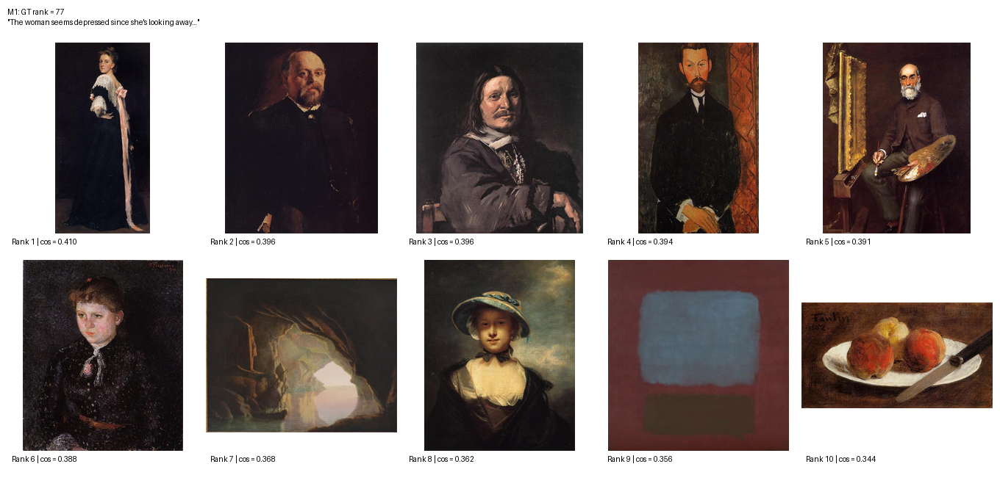

M1 Utterance 735 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.973977,kitagawa-utamaro_women-gathering-for-tooth-bla...,The woman is foreign to me which makes for an ...
1,2,0.970766,canaletto_view-of-a-river-perhaps-in-padua-1745,I'm very curious to know who lives here. The o...
2,3,0.969102,albrecht-durer_portrait-of-erasmus-of-rotterdam,The man doesn't want to sit for the portrait. ...
3,4,0.969046,fernand-leger_study-of-women-at-the-plant,The face looks friendly and is smiling slightl...
4,5,0.968391,salvador-dali_portrait-of-my-father-1921,The woman looks as if she is running away from...


M1 Utterance 735 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.989167,albrecht-durer_portrait-of-erasmus-of-rotterdam,john-singer-sargent_dorothy-barnard
1,2,0.985670,marc-chagall_biblical-subject-1956,john-singer-sargent_dorothy-barnard
2,3,0.981612,henri-de-toulouse-lautrec_m-lender-sitting-1895,john-singer-sargent_dorothy-barnard
3,4,0.977407,albrecht-durer_portrait-donors,john-singer-sargent_dorothy-barnard
4,5,0.970487,gustave-dore_jephthah-s-daughter-comes-to-meet...,john-singer-sargent_dorothy-barnard


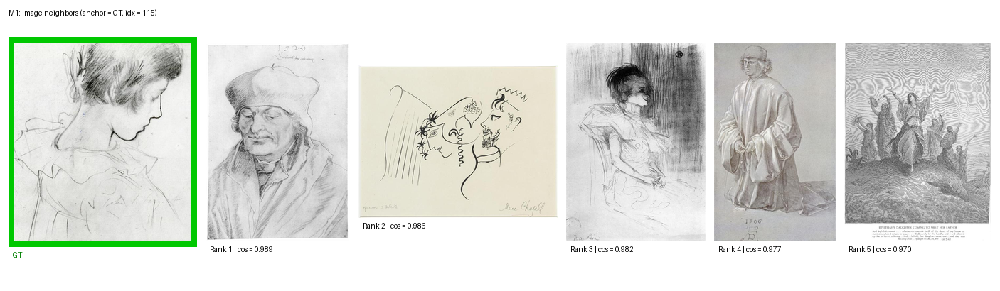


 Utterance 610 
Text: The flowers are beautiful and they make me feel content....
Painting ID: henri-fantin-latour_roses-in-a-white-porcelin-vase-1874
GT rank: 6


M1: Utterance 610 — Top-10 retrieval

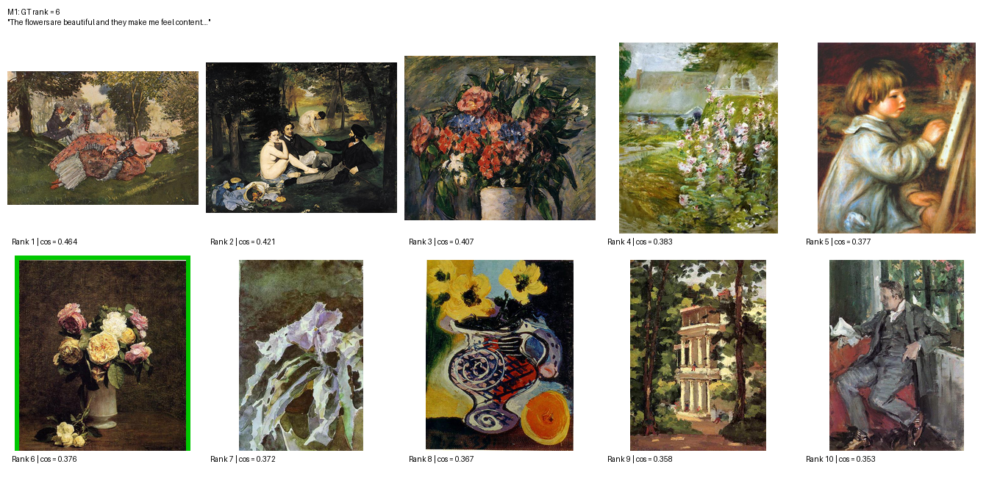

M1 Utterance 610 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.990826,maurice-prendergast_roma-flower-stall-also-kno...,"At a market of flowers , and everyone looks co..."
1,2,0.985061,pyotr-konchalovsky_still-life-with-red-gladiol...,these colorful flowers look like teenagers fre...
2,3,0.984067,paul-cezanne_pot-of-flowers-1876,what was with the obsession with painting jars...
3,4,0.982584,eugene-delacroix_study-of-flowers-1850(1),Three sketches of different types of flowers a...
4,5,0.982329,vincent-van-gogh_thistles-1888,Flowers look like they are grown out of the th...


M1 Utterance 610 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.924920,william-merritt-chase_seated-woman-in-black-dress,henri-fantin-latour_roses-in-a-white-porcelin-...
1,2,0.869872,edouard-manet_the-luncheon-on-the-grass-1863,henri-fantin-latour_roses-in-a-white-porcelin-...
2,3,0.856444,henri-fantin-latour_plate-of-peaches-1862,henri-fantin-latour_roses-in-a-white-porcelin-...
3,4,0.851577,paul-cezanne_young-girl-with-a-doll,henri-fantin-latour_roses-in-a-white-porcelin-...
4,5,0.850731,william-merritt-chase_portrait-of-worthington-...,henri-fantin-latour_roses-in-a-white-porcelin-...


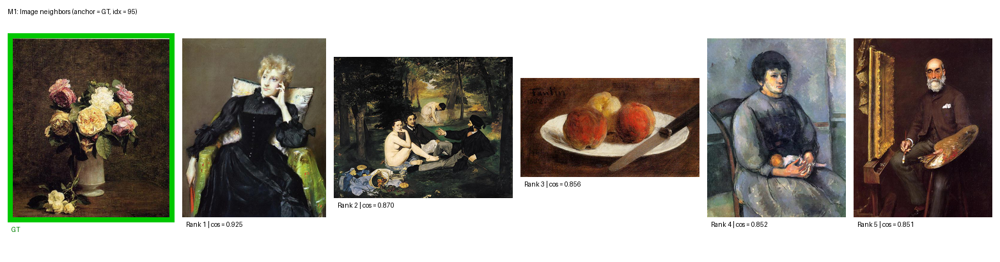


 Utterance 78 
Text: The neck on the lady seems to be exaggerated to a long length...
Painting ID: amedeo-modigliani_seated-jeanne-hebuterne-1918
GT rank: 64


M1: Utterance 78 — Top-10 retrieval

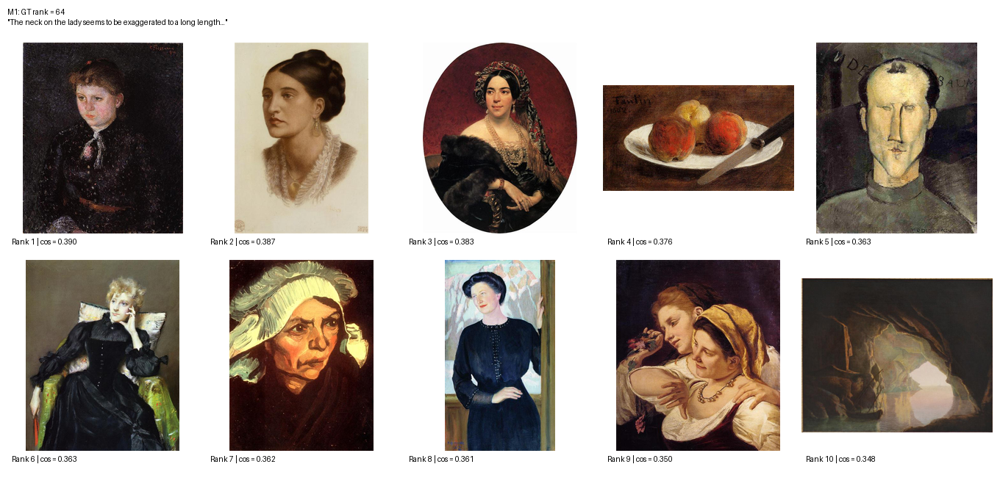

M1 Utterance 78 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.984444,john-singer-sargent_dorothy-barnard,A young girl seems to be engaged in her chores.
1,2,0.977821,dante-gabriel-rossetti_portrait-of-mrs-georgin...,the skin and eyes on this woman are beautiful
2,3,0.974202,vincent-van-gogh_sien-pregnant-walking-with-ol...,Two older women in long dresses discuss a matt...
3,4,0.972016,pierre-auguste-renoir_portrait-of-claude-renoi...,The child seems focused on painting his portrait.
4,5,0.969698,john-singer-sargent_dorothy-barnard,The young girl has a sad expression as she loo...


M1 Utterance 78 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.935212,egon-schiele_procession-1911,amedeo-modigliani_seated-jeanne-hebuterne-1918
1,2,0.931879,pablo-picasso_the-brutal-embrace-1900,amedeo-modigliani_seated-jeanne-hebuterne-1918
2,3,0.913063,amedeo-modigliani_portrait-of-paul-alexander,amedeo-modigliani_seated-jeanne-hebuterne-1918
3,4,0.892220,amedeo-modigliani_lunia-czechowska-with-her-le...,amedeo-modigliani_seated-jeanne-hebuterne-1918
4,5,0.881138,maurice-utrillo_bievre,amedeo-modigliani_seated-jeanne-hebuterne-1918


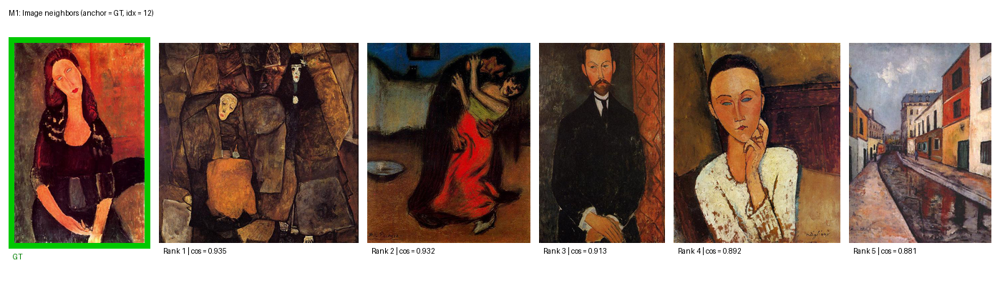


 Model: M2 
Features: text (1360, 512), image (214, 512), mapping = 214

 Utterance 735 
Text: The woman seems depressed since she's looking away...
Painting ID: john-singer-sargent_dorothy-barnard
GT rank: 32


M2: Utterance 735 — Top-10 retrieval

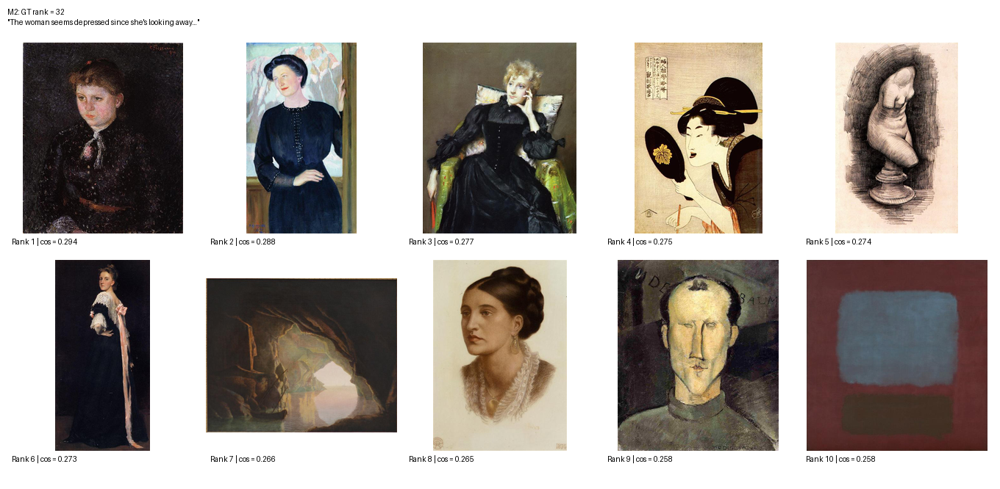

M2 Utterance 735 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.974899,fernand-leger_women-in-compact,I feel curious because the woman looks like sh...
1,2,0.974430,vincent-van-gogh_head-of-a-peasant-woman-with-...,The woman looks like she's panicking about som...
2,3,0.973865,kitagawa-utamaro_women-gathering-for-tooth-bla...,The woman is foreign to me which makes for an ...
3,4,0.973179,augustus-john_lady-mary-alington-1930,I am bored because the woman being painted loo...
4,5,0.962614,vincent-van-gogh_sien-pregnant-walking-with-ol...,The two women appear sad and depressed about t...


M2 Utterance 735 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.992402,albrecht-durer_portrait-of-erasmus-of-rotterdam,john-singer-sargent_dorothy-barnard
1,2,0.982578,marc-chagall_biblical-subject-1956,john-singer-sargent_dorothy-barnard
2,3,0.972675,henri-de-toulouse-lautrec_m-lender-sitting-1895,john-singer-sargent_dorothy-barnard
3,4,0.970284,gustave-dore_jephthah-s-daughter-comes-to-meet...,john-singer-sargent_dorothy-barnard
4,5,0.967719,ivan-shishkin_the-sketch-for-the-painting-rye-...,john-singer-sargent_dorothy-barnard


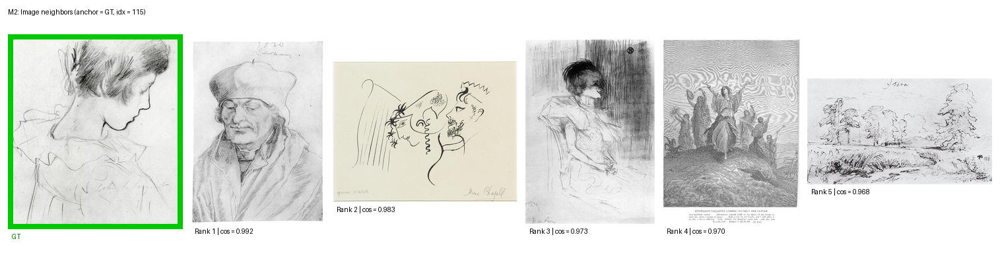


 Utterance 610 
Text: The flowers are beautiful and they make me feel content....
Painting ID: henri-fantin-latour_roses-in-a-white-porcelin-vase-1874
GT rank: 3


M2: Utterance 610 — Top-10 retrieval

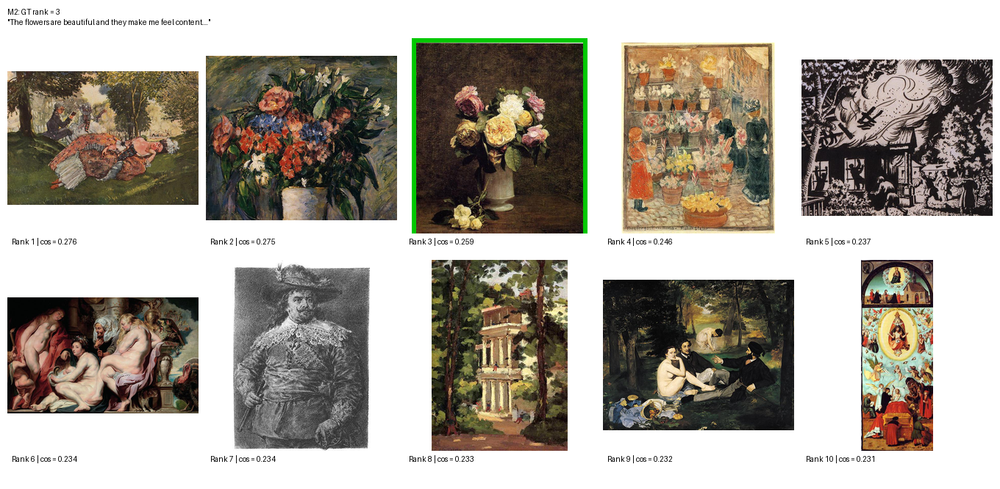

M2 Utterance 610 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.983453,eugene-delacroix_study-of-flowers-1850(1),"Very simple but nicely painted flowers, looks ..."
1,2,0.976961,pyotr-konchalovsky_still-life-with-red-gladiol...,these colorful flowers look like teenagers fre...
2,3,0.976102,konstantin-somov_cover-of-theater-program-thea...,flowers always bring a sense of calmness
3,4,0.973863,pyotr-konchalovsky_still-life-with-red-gladiol...,I enjopy flowers and the painting is of some o...
4,5,0.973052,maurice-prendergast_roma-flower-stall-also-kno...,"At a market of flowers , and everyone looks co..."


M2 Utterance 610 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.873379,edouard-manet_the-luncheon-on-the-grass-1863,henri-fantin-latour_roses-in-a-white-porcelin-...
1,2,0.864589,william-merritt-chase_seated-woman-in-black-dress,henri-fantin-latour_roses-in-a-white-porcelin-...
2,3,0.854509,paul-cezanne_pot-of-flowers-1876,henri-fantin-latour_roses-in-a-white-porcelin-...
3,4,0.851004,konstantin-somov_asleep-on-the-grass-young-woman,henri-fantin-latour_roses-in-a-white-porcelin-...
4,5,0.836503,ilya-repin_raising-of-jairus-daughter-1870,henri-fantin-latour_roses-in-a-white-porcelin-...


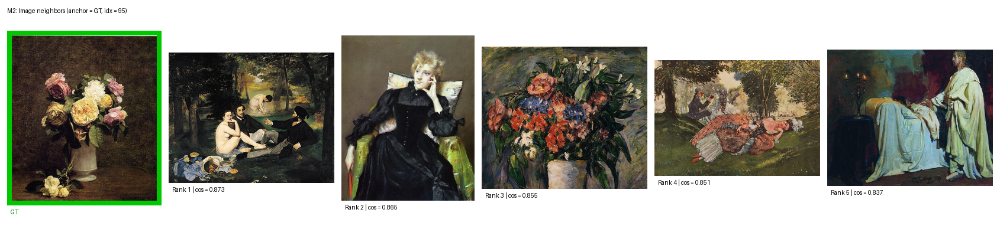


 Utterance 78 
Text: The neck on the lady seems to be exaggerated to a long length...
Painting ID: amedeo-modigliani_seated-jeanne-hebuterne-1918
GT rank: 52


M2: Utterance 78 — Top-10 retrieval

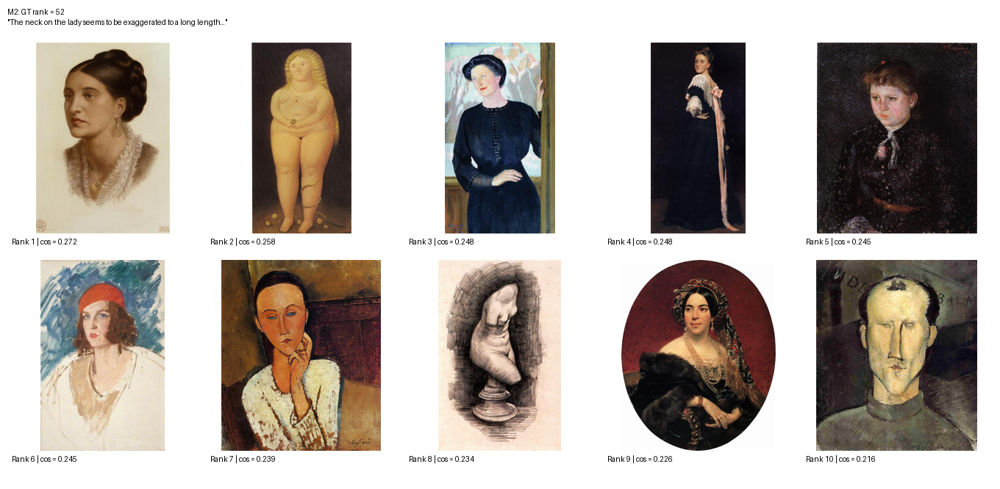

M2 Utterance 78 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.971492,john-singer-sargent_dorothy-barnard,The young girl has a sad expression as she loo...
1,2,0.970893,camille-pissarro_portrait-of-nini-1884,The girl's face looks sad and upset.
2,3,0.966097,boris-kustodiev_portrait-of-n-i-zelenskaya-1912,"IS a lady dressed with a black dress, she has ..."
3,4,0.957153,vincent-van-gogh_head-of-a-peasant-woman-with-...,an older woman wearing old fashioned black dre...
4,5,0.956387,karl-bryullov_portrait-of-princess-z-a-volkons...,A very beautiful woman is wearing a turbanlike...


M2 Utterance 78 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.918505,amedeo-modigliani_lunia-czechowska-with-her-le...,amedeo-modigliani_seated-jeanne-hebuterne-1918
1,2,0.902193,amedeo-modigliani_portrait-of-paul-alexander,amedeo-modigliani_seated-jeanne-hebuterne-1918
2,3,0.885744,egon-schiele_procession-1911,amedeo-modigliani_seated-jeanne-hebuterne-1918
3,4,0.867966,pablo-picasso_the-brutal-embrace-1900,amedeo-modigliani_seated-jeanne-hebuterne-1918
4,5,0.864367,georges-braque_big-trees-at-estaque-1908,amedeo-modigliani_seated-jeanne-hebuterne-1918


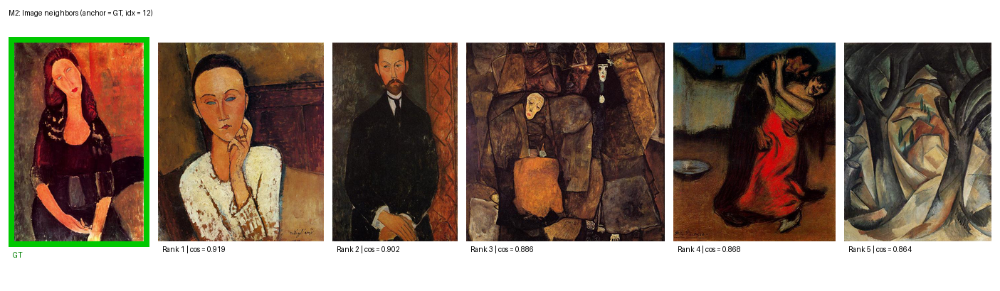


 Model: M3 
Features: text (1360, 512), image (214, 512), mapping = 214

 Utterance 735 
Text: The woman seems depressed since she's looking away...
Painting ID: john-singer-sargent_dorothy-barnard
GT rank: 20


M3: Utterance 735 — Top-10 retrieval

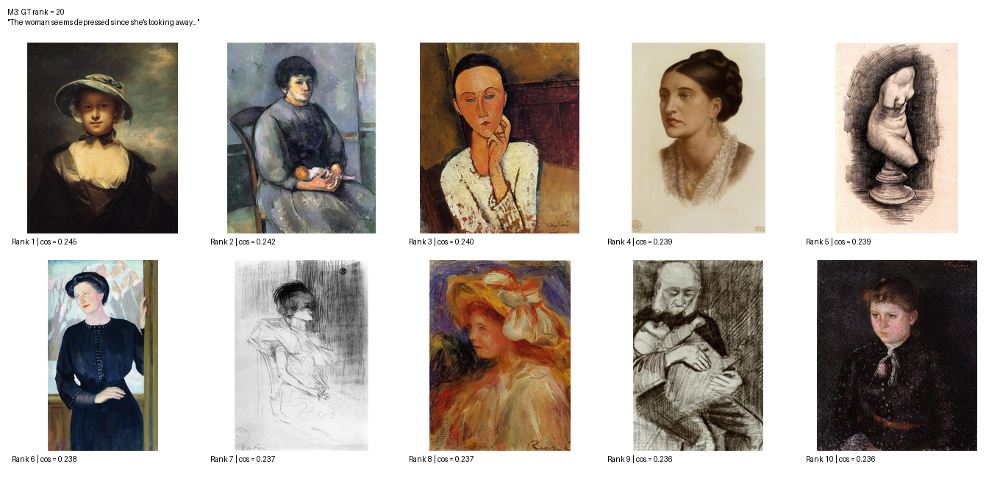

M3 Utterance 735 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.993048,fernand-leger_study-of-women-at-the-plant,Her face of contemplation makes me contemplative.
1,2,0.990765,fernand-leger_women-in-compact,I feel curious because the woman looks like sh...
2,3,0.990738,camille-pissarro_portrait-of-nini-1884,Her expression is full of worry and sadness.
3,4,0.990613,odilon-redon_temptation,The way this woman is positioned and her facia...
4,5,0.990286,augustus-john_lady-mary-alington-1930,I am bored because the woman being painted loo...


M3 Utterance 735 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.956134,dante-gabriel-rossetti_portrait-of-mrs-georgin...,john-singer-sargent_dorothy-barnard
1,2,0.952488,vincent-van-gogh_torso-of-venus-1,john-singer-sargent_dorothy-barnard
2,3,0.937311,henri-de-toulouse-lautrec_m-lender-sitting-1895,john-singer-sargent_dorothy-barnard
3,4,0.936716,vincent-van-gogh_orphan-man-with-a-baby-in-his...,john-singer-sargent_dorothy-barnard
4,5,0.936220,henri-de-toulouse-lautrec_may-milton-1895,john-singer-sargent_dorothy-barnard


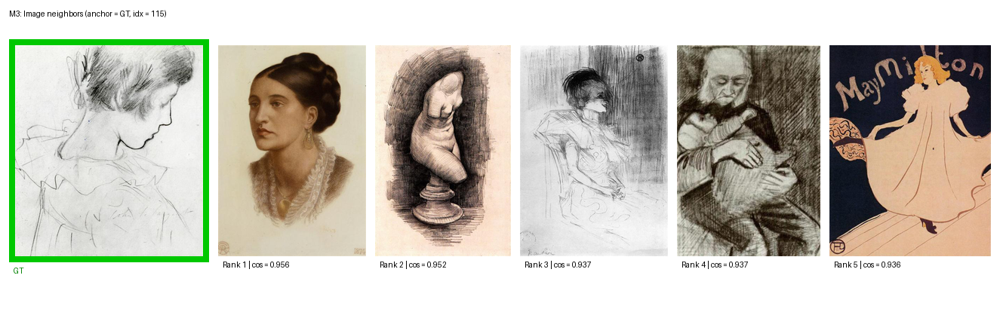


 Utterance 610 
Text: The flowers are beautiful and they make me feel content....
Painting ID: henri-fantin-latour_roses-in-a-white-porcelin-vase-1874
GT rank: 3


M3: Utterance 610 — Top-10 retrieval

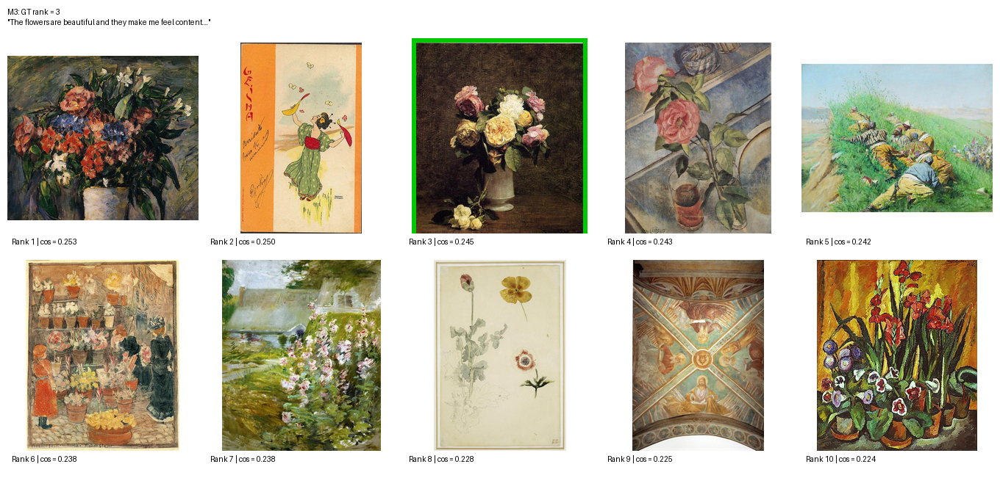

M3 Utterance 610 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.996709,konstantin-somov_cover-of-theater-program-thea...,flowers always bring a sense of calmness
1,2,0.996574,henri-fantin-latour_roses-in-a-white-porcelin-...,these flowers are so pretty with the color com...
2,3,0.992566,pyotr-konchalovsky_still-life-with-red-gladiol...,I enjopy flowers and the painting is of some o...
3,4,0.991789,eugene-delacroix_study-of-flowers-1850(1),"Very simple but nicely painted flowers, looks ..."
4,5,0.986246,eugene-delacroix_study-of-flowers-1850(1),"I love the simplicity of the flower petals, ve..."


M3 Utterance 610 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.954439,kuzma-petrov-vodkin_still-life-with-roses-1922,henri-fantin-latour_roses-in-a-white-porcelin-...
1,2,0.935818,paul-cezanne_pot-of-flowers-1876,henri-fantin-latour_roses-in-a-white-porcelin-...
2,3,0.930425,pyotr-konchalovsky_still-life-with-red-gladiol...,henri-fantin-latour_roses-in-a-white-porcelin-...
3,4,0.921435,odilon-redon_temptation,henri-fantin-latour_roses-in-a-white-porcelin-...
4,5,0.918190,raphael-kirchner_geisha,henri-fantin-latour_roses-in-a-white-porcelin-...


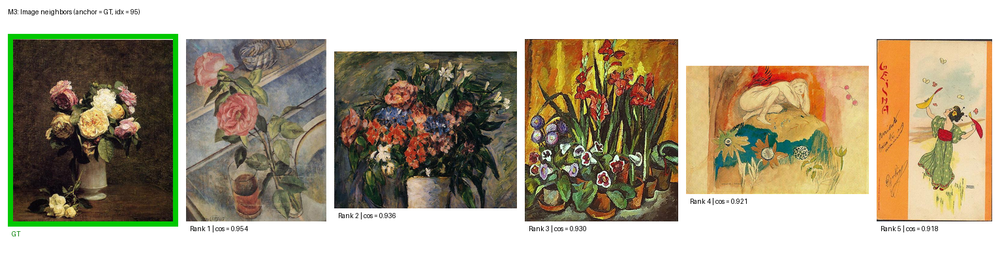


 Utterance 78 
Text: The neck on the lady seems to be exaggerated to a long length...
Painting ID: amedeo-modigliani_seated-jeanne-hebuterne-1918
GT rank: 7


M3: Utterance 78 — Top-10 retrieval

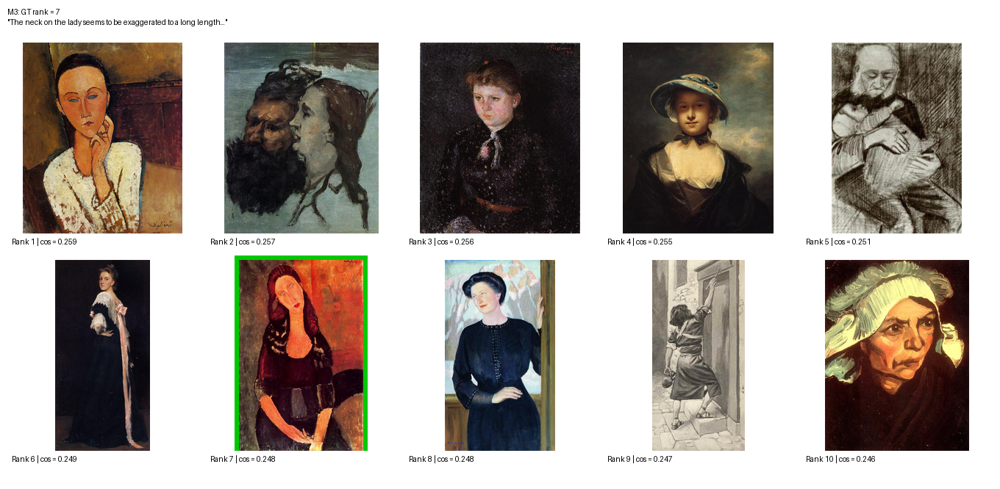

M3 Utterance 78 — Text neighbors

,rank,cosine_similarity,neighbor_painting_id,neighbor_text
0,1,0.984403,edgar-degas_dancer-1874,The girl seems to be reaching for her neck in ...
1,2,0.983382,henri-de-toulouse-lautrec_m-lender-sitting-1895,The woman has exaggerated attire and the weird...
2,3,0.982479,edgar-degas_dancer-1874,"I feel sorry for her, I can practically feel h..."
3,4,0.981260,vincent-van-gogh_head-of-a-peasant-woman-with-...,The woman looks like she's panicking about som...
4,5,0.980227,john-singer-sargent_head-of-capri-girl,"She's not happy or sad, but she is fierce."


M3 Utterance 78 — Image neighbors (anchor = GT)

,rank,cosine_similarity,neighbor_painting_id,anchor_painting_id
0,1,0.944134,pablo-picasso_the-brutal-embrace-1900,amedeo-modigliani_seated-jeanne-hebuterne-1918
1,2,0.943337,pablo-picasso_woman-sitting-in-an-armchair,amedeo-modigliani_seated-jeanne-hebuterne-1918
2,3,0.935878,amedeo-modigliani_lunia-czechowska-with-her-le...,amedeo-modigliani_seated-jeanne-hebuterne-1918
3,4,0.931982,georges-braque_big-trees-at-estaque-1908,amedeo-modigliani_seated-jeanne-hebuterne-1918
4,5,0.929674,boris-kustodiev_portrait-of-n-i-zelenskaya-1912,amedeo-modigliani_seated-jeanne-hebuterne-1918


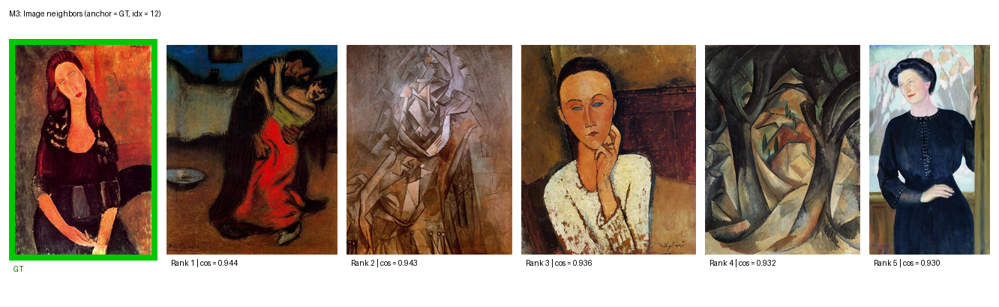

All results saved.


In [7]:
# Define a function to export embeddings for 3 models
def export_all_embeddings():
    # Load the dataset
    csv_path = "/Users/cyq/Desktop/Dissertation/Database/test_set.csv"
    # Define model configurations
    model_configs = {
        "M1": {
            "model_path": "/Users/cyq/Desktop/Dissertation/Database/m1_clip_trained/best_checkpoint.pt",
            "out_dir": "/Users/cyq/Desktop/Dissertation/Database/embeds_m1"
        },
        "M2": {
            "model_path": "/Users/cyq/Desktop/Dissertation/Database/m2_lora_full/best_checkpoint.pt", 
            "out_dir": "/Users/cyq/Desktop/Dissertation/Database/embeds_m2"
        },
        "M3": {
            "model_path": "/Users/cyq/Desktop/Dissertation/Database/m3_clip_trained/best_checkpoint.pt",
            "out_dir": "/Users/cyq/Desktop/Dissertation/Database/embeds_m3"
        }
    }
    # Export embeddings for all three models
    export_all_model_embeddings(
        csv_path = csv_path,
        model_configs = model_configs,
        hf_backbone = "openai/clip-vit-base-patch32",
        device = select_device(),
        batch_size = 64
    )

# Define a function to run utterance examples for tht qualitative analysis across 3 models
def utt_examples(sample_k = 3, seed = 985, topk = 10):
    # Load the dataset
    csv_path = "/Users/cyq/Desktop/Dissertation/Database/test_set.csv"
    # Load the embedding directories for the three models
    embedding_dirs = {
        "M1": "/Users/cyq/Desktop/Dissertation/Database/embeds_m1",
        "M2": "/Users/cyq/Desktop/Dissertation/Database/embeds_m2",
        "M3": "/Users/cyq/Desktop/Dissertation/Database/embeds_m3"
    }
    # Run the performance analysis and visualisation
    return analyze_model_performance(
        csv_path = csv_path,
        embedding_dirs = embedding_dirs,
        sample_k = sample_k,
        seed = seed,
        topk = topk,
        out_root = "/Users/cyq/Desktop/Dissertation/Database/QualPanels",
        show_in_notebook = True
    )

# Perform embedding export for all models
export_all_embeddings()

# Perform the utterance examples
results = utt_examples(sample_k = 3, seed = 95, topk = 10)

In [8]:
# -------------------- Summarise Training Cost --------------------
import os
import pandas as pd

# Define log file paths for 3 models
logs = {
    "M1": "/Users/cyq/Desktop/Dissertation/Database/m1_clip_trained/m1_epoch_metrics.csv",
    "M2": "/Users/cyq/Desktop/Dissertation/Database/m2_lora_full/epoch_metrics_m2_full.csv",
    "M3": "/Users/cyq/Desktop/Dissertation/Database/m3_clip_trained/m3_epoch_metrics.csv",
}

# Define the outputs path
out_path = "/Users/cyq/Desktop/Dissertation/Database/training_cost_summary.csv"

# Load the training logs
dfs = {name: pd.read_csv(path) for name, path in logs.items()}

# Extract the key metrics
summary_rows = []
for name, df in dfs.items():
    row = {
        "Model": name,
        # Parameter size
        "Trainable Params (M)": df["trainable_params_M"].iloc[-1],
        "Total Params (M)": df["total_params_M"].iloc[-1],
        # Checkpoint size
        "Checkpoint Size (MB)": df["ckpt_best_MB"].iloc[-1],
        # Average epoch time and throughput
        "Avg. Epoch Time (s)": df["epoch_time_sec"].mean(),
        "Throughput (samples/s)": df["throughput_samples_per_sec"].mean(),
    }
    summary_rows.append(row)

# Convert into a dataframe
summary_df = pd.DataFrame(summary_rows)

# Save the summary table into csv and print it
summary_df.to_csv(out_path, index = False)
print(summary_df.to_markdown(index = False))

| Model   |   Trainable Params (M) |   Total Params (M) |   Checkpoint Size (MB) |   Avg. Epoch Time (s) |   Throughput (samples/s) |
|:--------|-----------------------:|-------------------:|-----------------------:|----------------------:|-------------------------:|
| M1      |              151.277   |            151.277 |                1815.82 |              1607.96  |                  9.97724 |
| M2      |                5.07904 |            156.356 |                 666.72 |               673.306 |                 16.1729  |
| M3      |              151.277   |            151.277 |                1815.82 |              1203.68  |                  9.04736 |
